In [52]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt

from numpy import genfromtxt


import pandas as pd

from mpl_toolkits import mplot3d
#%matplotlib notebook

import math

In [2]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import LinearSegmentedColormap



cmap_green = LinearSegmentedColormap.from_list('mycmap', [(0.0, 'darkgreen'),
                                                          (0.5, 'lime'),
                                                    (1.0, 'aquamarine')]
                                        )

cmap_magenta = LinearSegmentedColormap.from_list('mycmap', [(0.0, 'purple'),
                                                          (0.5, 'magenta'),
                                                    (1.0, 'pink')]
                                        )


cmap_red = LinearSegmentedColormap.from_list('mycmap', [(0.0, 'maroon'),
                                                          (0.5, 'red'),
                                                    (1.0, 'orange')]
                                        )



# read in the data

In [3]:
inputParameters = pd.read_csv('../_inputParameters.csv',names=['key','value'])
inputParameters.style.set_properties(**{'text-align': 'left'})
#inputParameters

,key,value
0,inputDataFolder,/Users/johannesschoeneberg/Desktop/PostDoc/drubin_lab/organoids_lattice_data/data_/2016_04_25Daphne/Sample3_CD_10ulMG/Position5_Basal_apical_ObjScan/matlab_decon
1,outputDataFolder,/Users/johannesschoeneberg/Desktop/PostDoc/drubin_lab/organoids_lattice_data/data_/2016_04_25Daphne/Sample3_CD_10ulMG/Position5_Basal_apical_ObjScan/matlab_decon/output
2,movieLength,70
3,allowedMaxNumDetectionsPerFrame,3000
4,framerate_msec,5689
5,ch0_outputDataFolder,output_488
6,ch0_uniqueFilenameString,488nm_0
7,ch0_detectionFilename,Detection3D.mat
8,ch0_trackingFilename,trackedFeatures.mat
9,ch0_trackingCsvFilename,trackedFeatures.csv


In [4]:
def getInputParameter(inputParametersPandas,key):
    #this locates the row, gets the result out of its array form and strips whitespaces away
    return (((inputParametersPandas.loc[inputParametersPandas['key'] == key]).values)[0,1]).strip()

In [5]:
outputDataFolder = getInputParameter(inputParameters,"outputDataFolder")
ch0_outputDataFolder  = getInputParameter(inputParameters,"ch0_outputDataFolder")
ch0_trackingCsvFilename = getInputParameter(inputParameters,"ch0_trackingCsvFilename")
ch1_outputDataFolder  = getInputParameter(inputParameters,"ch1_outputDataFolder")
ch1_trackingCsvFilename = getInputParameter(inputParameters,"ch1_trackingCsvFilename")
#trackColor = getInputParameter(inputParameters,"trackColor")
#trackingBildFilename = getInputParameter(inputParameters,"trackingBildFilename")
#framerate_msec = float(getInputParameter(inputParameters,"framerate_msec"))
#movieLength = float(getInputParameter(inputParameters,"movieLength"))
#print(trackColor)



In [6]:
data0 = pd.read_csv(outputDataFolder+'/'+ch0_outputDataFolder+'/'+ch0_trackingCsvFilename,header=0)
data0.columns = ["trackId", "tracklength", "frameId", "particleId", "x", "y", "z", "A", "noIdea1", "noIdea2", "noIdea3", "noIdea4"]
trackIdsLong0 = (data0[data0['tracklength'] > 10]).drop_duplicates(subset='trackId')['trackId'].values
trackIds0 = data0.drop_duplicates(subset='trackId')['trackId'].values
#data0 = data0.drop_duplicates(subset='trackId')

data1 = pd.read_csv(outputDataFolder+'/'+ch1_outputDataFolder+'/'+ch1_trackingCsvFilename,header=0)
data1.columns = ["trackId", "tracklength", "frameId", "particleId", "x", "y", "z", "A", "noIdea1", "noIdea2", "noIdea3", "noIdea4"]
trackIdsLong1 = (data1[data1['tracklength'] > 10]).drop_duplicates(subset='trackId')['trackId'].values
trackIds1 = data1.drop_duplicates(subset='trackId')['trackId'].values
data1[0:5]

,trackId,tracklength,frameId,particleId,x,y,z,A,noIdea1,noIdea2,noIdea3,noIdea4
0,1,70,1,123,2.401194e+02,3.449448e+02,4.499062e+01,1.935832e+04,7.636581e-02,7.634770e-02,7.634294e-02,8.918059e+02
1,1,70,2,0,2.398080e+02,3.455938e+02,4.452885e+01,2.285881e+04,5.624323e-02,5.640477e-02,5.648089e-02,7.705259e+02
2,1,70,3,121,2.396020e+02,3.457261e+02,4.401741e+01,2.191670e+04,6.825404e-02,6.812530e-02,6.801579e-02,8.966284e+02
3,1,70,4,90,2.400139e+02,3.457024e+02,4.475419e+01,2.231589e+04,5.023574e-02,5.033191e-02,5.030067e-02,6.751585e+02
4,1,70,5,85,2.397104e+02,3.454962e+02,4.467903e+01,2.411560e+04,5.471115e-02,5.492841e-02,5.473449e-02,7.897406e+02


In [81]:
class Track:
    def __init__(self,pandasTrackData):
        tracklength = int((pandasTrackData['tracklength'].values)[0])
        
        #trim the end of the track until you got rid of all the nans
        xCoordLastEntry = pandasTrackData[tracklength-1:tracklength]['x'].astype(float).values
        #print(xCoordLastEntry,tracklength)
        while np.isnan(xCoordLastEntry):
            tracklength = tracklength-1
            xCoordLastEntry = pandasTrackData[tracklength-1:tracklength]['x'].astype(float).values
            #print(xCoordLastEntry,tracklength)
        
        track = pandasTrackData[0:tracklength] # this function kills all the NaNs that come from matlab
        
        self.id = track['trackId'].astype(int).values[0]
        self.len = tracklength

        self.coords = track[['x','y','z']].astype(float).values
        
            
        self.cm = np.nanmean(self.coords,axis=0)
        self.maxDist = np.linalg.norm(self.coords[0]-self.coords[-1])
        
        self.particleIDs = track['particleId'].astype(int).values
        self.A = track['A'].astype(float).values
        self.Amean = np.nanmean(self.A)

        self.frameIDs = track['frameId'].astype(int).values
        
    def reveal(self):
        print('id',self.id)
        print('tracklength',self.len)
        print('center of mass',self.cm)
        print('coords',self.coords)
        print('particleIDs',self.particleIDs)
        print('A',self.A)
        print('frameIDs',self.frameIDs)

           
    def plot(self):
        plt.figure(dpi=300)
        ax = plt.axes(projection='3d')
        ax.plot3D(self.coords[:,0], self.coords[:,1], self.coords[:,2], 'grey')
        ax.scatter3D(self.coords[:,0], self.coords[:,1], self.coords[:,2],c=self.A, cmap='plasma',s=100);
        plt.xlabel('x [px]')
        plt.ylabel('y [px]')
        
    def writeBILD(self,BILDfilename,color='black',center=[]):
        filename=BILDfilename
        file = open(BILDfilename,'w') 

        file.write(".transparency 0.5\n")
        file.write(".color "+color+"\n")
    
        line = ".comment trackID"+str(self.id)+"\n"
        file.write(line)
        

        
        for i in range(1,self.len):
            tzero = self.coords[i-1]
            tone = self.coords[i]
            if len(center) != 0:
                tzero = tzero-center
                tone = tone-center

            
    
            # Data for a three-dimensional line
            x0 = float(tzero[0])
            y0 = float(tzero[1])
            z0 = float(tzero[2])
            A0 = float(self.A[i-1])
            
            x1 = float(tone[0])
            y1 = float(tone[1])
            z1 = float(tone[2])
            A1 = float(self.A[i])
            
            if(math.isnan(x0) or math.isnan(y0) or math.isnan(z0) or math.isnan(x1) or math.isnan(y1) or math.isnan(z1)):
                line = ".arrow "+str(x0)+" "+str(y0)+" "+str(z0)+" "+str(x1)+" "+str(y1)+" "+str(z1)+"\n" #" "+str(radius)+"\n"        
                print(line)
                file.write(".comment "+line)
                continue
                    
            line = ".arrow "+str(x0)+" "+str(y0)+" "+str(z0)+" "+str(x1)+" "+str(y1)+" "+str(z1)+"\n" #" "+str(radius)+"\n"        
            file.write(line)
        
        file.close()

In [82]:
import timeit

start_time = timeit.default_timer()

tracks0 = []
cm0 = []
len0 = []
Amean0 = []
maxDist0 = []

for i in range(0,len(trackIdsLong0)):
    if(i %1000 == 0):
        print(str(i)+"/"+str(len(trackIdsLong0)))
    a = Track(data0[data0['trackId'] == trackIdsLong0[i]])
    tracks0.append(a)
    cm0.append(a.cm)
    len0.append(a.len)
    Amean0.append(a.Amean)
    maxDist0.append(a.maxDist)
    
elapsed = timeit.default_timer() - start_time
print('time elapse: '+str(np.round(elapsed,decimals=2))+'s')

0/3985
1000/3985
2000/3985
3000/3985
time elapse: 14.22s


In [83]:
t0 = tracks0[bestTrackMatches[ID][1]]
filename = 'track_488_'+str(t0.id)+'.bild'

print(filename)
t0.writeBILD(filename,color='green',center=t0.cm-np.array([20,20,20]))

t1 = tracks1[bestTrackMatches[ID][0]]
filename = 'track_560_'+str(t1.id)+'.bild'
print(filename)
t1.writeBILD(filename,color='red',center=t1.cm-np.array([20,20,20]))

track_488_211.bild
.arrow 16.72964814814813 19.706625925926005 22.197381111111106 nan nan nan

.arrow nan nan nan 19.266248148148122 20.778725925925983 19.237131111111104

.arrow 14.757948148148131 21.11572592592597 18.87269111111111 nan nan nan

.arrow nan nan nan 14.766148148148119 21.391125925925962 16.102091111111108

.arrow 14.766148148148119 21.391125925925962 16.102091111111108 nan nan nan

.arrow nan nan nan 14.160248148148128 20.695725925926013 16.803351111111105

track_560_30.bild
.arrow 18.818994202898523 21.057807246376797 16.787627101449267 nan nan nan

.arrow nan nan nan 20.28009420289851 20.89630724637675 17.303977101449263



(-500, 500)

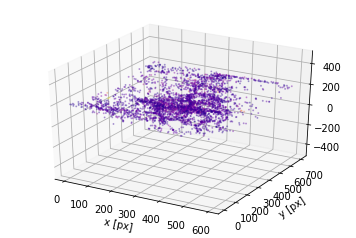

In [31]:
cm0 = np.array(cm0)
#plt.figure(dpi=300)
ax = plt.axes(projection='3d')
ax.scatter3D(cm0[:,0], cm0[:,1], cm0[:,2],c=np.log(Amean0),cmap='plasma',s=1,alpha=0.3);
plt.xlabel('x [px]')
plt.ylabel('y [px]')
#plt.xlim(-200,800)
#plt.ylim(-200,800)
ax.set_zlim(-500,500)

In [90]:
import timeit

start_time = timeit.default_timer()


tracks1 = []
cm1 = []
Amean1 = []
Afirst = []
maxDist1 = []
len1= []
for i in range(0,len(trackIdsLong1)):
    if(i %1000 == 0):
        print(str(i)+"/"+str(len(trackIdsLong1)))
    a = Track(data1[data1['trackId'] == trackIdsLong1[i]])
    tracks1.append(a)
    cm1.append(a.cm)
    len1.append(a.len)
    Amean1.append(a.Amean)
    Afirst.append(a.A[0])
    maxDist1.append(a.maxDist)
    
elapsed = timeit.default_timer() - start_time
print('time elapse: '+str(np.round(elapsed,decimals=2))+'s')

0/2066
1000/2066
2000/2066
time elapse: 5.49s


8
[214 281  90]


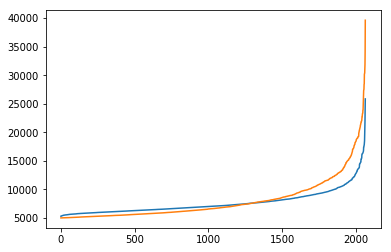

In [95]:
# get the track with the maximum average intensity
trackID = np.argmax(Afirst)
print(trackID)
trackMaxAmpl = tracks1[trackID]
plt.plot(np.sort(Amean1))
plt.plot(np.sort(Afirst))
print(trackMaxAmpl.cm.astype(int))
filename = 'track_560_'+str(trackID)+'.bild'
trackMaxAmpl.writeBILD(filename,color='magenta',center=trackMaxAmpl.coords[0]-np.array([20,20,20]))

In [97]:
trackMaxAmpl.coords

array([[ 221.4703 ,  277.9795 ,   91.38771],
       [ 220.822  ,  277.8963 ,   90.87967],
       [ 220.4222 ,  277.7063 ,   90.69712],
       [ 220.3429 ,  277.4874 ,   91.01104],
       [ 219.4553 ,  277.9116 ,   91.49389],
       [ 219.0977 ,  278.4957 ,   90.78164],
       [ 218.7131 ,  278.1135 ,   91.17352],
       [ 218.3536 ,  278.8312 ,   91.38822],
       [ 218.5388 ,  277.6865 ,   90.81555],
       [ 217.2589 ,  278.5852 ,   90.58641],
       [ 217.4947 ,  278.8218 ,   91.13576],
       [ 217.6639 ,  278.8476 ,   90.03566],
       [ 218.6794 ,  278.791  ,   90.7134 ],
       [ 216.7301 ,  278.8924 ,   90.13244],
       [ 216.659  ,  278.9118 ,   90.61344],
       [ 216.0836 ,  278.6867 ,   90.43236],
       [ 215.9097 ,  278.6498 ,   90.99632],
       [ 216.7043 ,  278.268  ,   90.96675],
       [ 215.9443 ,  278.4203 ,   90.98492],
       [ 216.3498 ,  278.8052 ,   91.49843],
       [ 216.7664 ,  280.6083 ,   91.35841],
       [ 215.8896 ,  281.4993 ,   91.44501],
       [ 2

In [98]:
trackMaxAmpl.cm

array([ 214.98012571,  281.93155857,   90.67524957])

(-500, 500)

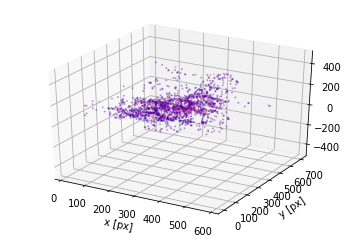

In [11]:
cm1 = np.array(cm1)
#plt.figure(dpi=300)
ax = plt.axes(projection='3d')
ax.scatter3D(cm1[:,0], cm1[:,1], cm1[:,2],c=np.log(Amean1),cmap='plasma',s=1,alpha=0.3);
plt.xlabel('x [px]')
plt.ylabel('y [px]')
#plt.xlim(-200,800)
#plt.ylim(-200,800)
ax.set_zlim(-500,500)

# find a neighborlist boxsize: first idea: how far do the particles travel max, that's the cutoff

Text(0,0.5,'dist(p[0],p[-1])')

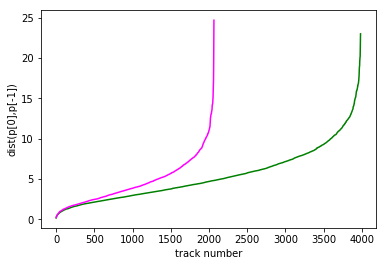

In [12]:
plt.plot(np.sort(maxDist0),c='green')
#plt.xlim(0,len(maxDist0))
plt.plot(np.sort(maxDist1),c='magenta')
#plt.xlim(0,len(maxDist1))
plt.xlabel('track number')
plt.ylabel('dist(p[0],p[-1])')

Text(0.5,1,'488')

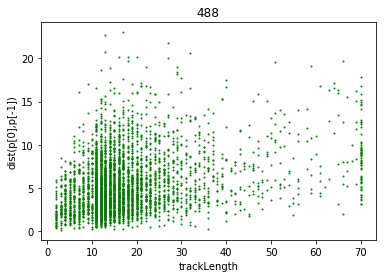

In [13]:
plt.scatter(len0,maxDist0,s=1,c='green')
plt.ylabel('dist(p[0],p[-1])')
plt.xlabel('trackLength')
plt.title('488')

Text(0.5,1,'560')

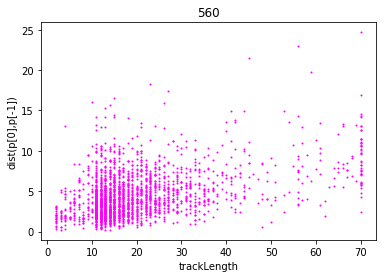

In [14]:
plt.scatter(len1,maxDist1,s=1,c='magenta')
plt.ylabel('dist(p[0],p[-1])')
plt.xlabel('trackLength')
plt.title('560')

# Brute force, no neighbor list:

In [17]:
import timeit

start_time = timeit.default_timer()
treshold = 1.0 #µm
distanceMatrix = np.zeros(shape=(len(tracks0),len(tracks1)))
matchingIDs = []
for i in range(0,len(tracks0)):
    if(i %1000 == 0):
        print(str(i)+"/"+str(len(tracks0)))
    for j in range(0,len(tracks1)):
        dist = np.linalg.norm(tracks0[i].cm-tracks1[j].cm)
        if(dist==0):
            track0[i].reveal()
            track1[i].reveal()
        distanceMatrix[i,j] = dist


#        if(dist<treshold):
#            matchingIDs_chc2dnm.append([tracks0[i].id ,tracks1[j].id,tracks0[i].cm,tracks1[j].cm,dist])
        
elapsed = timeit.default_timer() - start_time
print(elapsed)

0/3985
1000/3985
2000/3985
3000/3985
49.63401093299035


In [18]:
print('time to compute:',str(np.round(elapsed,decimals=2))+' seconds')

time to compute: 49.63 seconds


Text(0.5,0,'CoM coords 560')

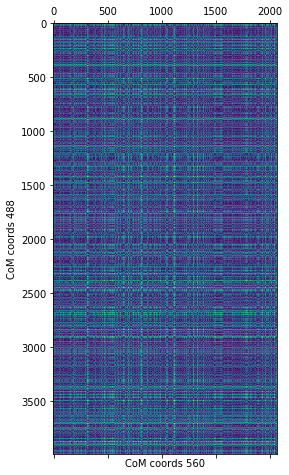

In [19]:
plt.matshow(distanceMatrix)
plt.ylabel("CoM coords 488")
plt.xlabel("CoM coords 560")

Text(0.5,0,'distance ID')

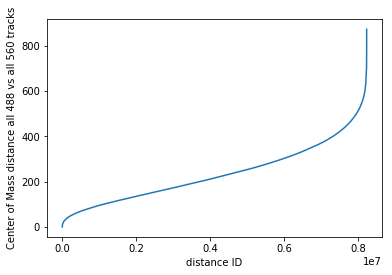

In [20]:
plt.plot(np.sort(distanceMatrix, axis=None))
plt.ylabel('Center of Mass distance all 488 vs all 560 tracks')
plt.xlabel('distance ID')
#plt.xlim(0,2000000)

[  42.54479543   84.02826817   92.75462303 ...,  617.86710289  646.23440459
  650.82612569]
1528


Text(0,0.5,"distance to all 488 tracks' CoM [µm]")

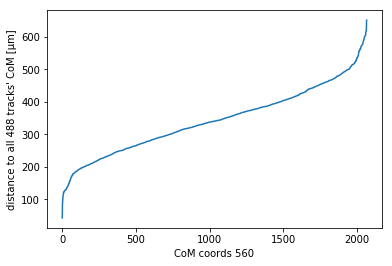

In [21]:
print(np.sort(distanceMatrix[3000]))
print(np.argmin(distanceMatrix[3000]))
plt.plot(np.sort(distanceMatrix[3000]))
plt.xlabel("CoM coords 560")
plt.ylabel("distance to all 488 tracks' CoM [µm]")

# look at the k smallest values for each track, and then do a more detailed match

In [22]:
trackID = 9
k=5
d=np.array(distanceMatrix[trackID,:])
idxs = np.argpartition(d, k)[:k]
#print(idx)
print(idxs)
print(d[idxs])

[ 803  431 1785 1320 1998]
[ 94.16360444  95.10081678  92.9344176   97.32127748  91.4062975 ]


In [23]:
bestTrackMatches = []
for i in range(0,len(distanceMatrix[0])):

    bestMatchId = np.argmin(distanceMatrix[:,i])
    bestDistance = distanceMatrix[:,i][bestMatchId]
    bestTrackMatches.append([i,bestMatchId,bestDistance])

Text(0,0.5,'dist between center of mass')

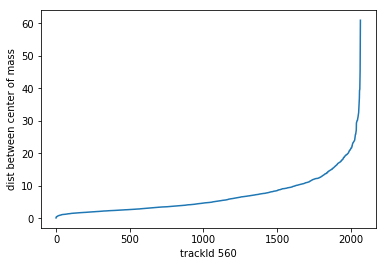

In [24]:
plt.plot(np.sort(np.array(bestTrackMatches)[:,2]))
plt.xlabel('trackId 560')
plt.ylabel('dist between center of mass')

Text(0,0.5,'differences between sorted ids')

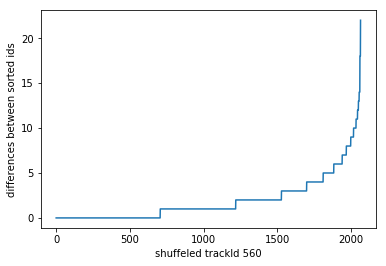

In [25]:
plt.plot(np.sort(np.diff(np.sort(np.array(bestTrackMatches)[:,1]))))
plt.xlabel('shuffeled trackId 560')
plt.ylabel('differences between sorted ids')

In [26]:
np.sort(bestTrackMatches)

array([[  0.00000000e+00,   2.75589361e+00,   1.56000000e+02],
       [  1.00000000e+00,   2.76261205e+00,   1.66000000e+02],
       [  2.00000000e+00,   6.05430903e+00,   2.86200000e+03],
       ..., 
       [  6.30545359e+00,   4.00000000e+01,   2.06300000e+03],
       [  4.31006359e+00,   2.06400000e+03,   3.70700000e+03],
       [  7.09523921e+00,   1.26200000e+03,   2.06500000e+03]])

[29, 210, 4.4086527716031423]
t0.cm [ 224.29615185  362.37867407   45.60376889]
t1.cm [ 224.0444058   363.92399275   41.4825029 ]


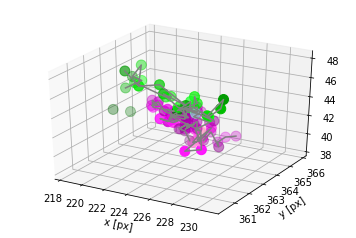

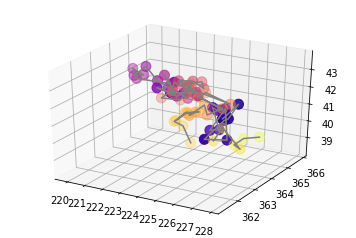

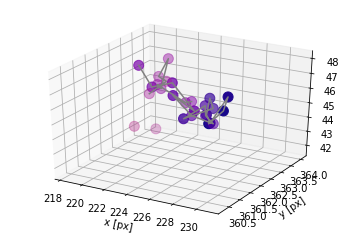

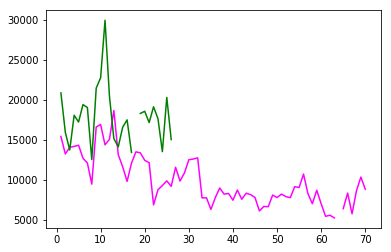

In [27]:
ID = 29

print(bestTrackMatches[ID])
t1 = tracks1[bestTrackMatches[ID][0]]
t0 = tracks0[bestTrackMatches[ID][1]]
print('t0.cm',t0.cm)
print('t1.cm',t1.cm)




#plt.figure(dpi=300)
ax = plt.axes(projection='3d')
ax.plot3D(t1.coords[:,0], t1.coords[:,1], t1.coords[:,2], 'grey')
ax.scatter3D(t1.coords[:,0], t1.coords[:,1], t1.coords[:,2],c=t1.A, cmap=cmap_magenta,s=100);

ax.plot3D(t0.coords[:,0], t0.coords[:,1], t0.coords[:,2], 'grey')
ax.scatter3D(t0.coords[:,0], t0.coords[:,1], t0.coords[:,2],c=t0.A, cmap=cmap_green,s=100);
plt.xlabel('x [px]')
plt.ylabel('y [px]')
plt.show()

#plt.figure(dpi=300)
maxLen = np.max([len(t1.frameIDs),len(t0.frameIDs)])
ax = plt.axes(projection='3d')
ax.plot3D(t1.coords[:,0], t1.coords[:,1], t1.coords[:,2], 'grey')
ax.scatter3D(t1.coords[:,0], t1.coords[:,1], t1.coords[:,2],c=t1.frameIDs,vmax=maxLen, cmap='plasma',s=100);
plt.show()
ax = plt.axes(projection='3d')
ax.plot3D(t0.coords[:,0], t0.coords[:,1], t0.coords[:,2], 'grey')
ax.scatter3D(t0.coords[:,0], t0.coords[:,1], t0.coords[:,2],c=t0.frameIDs,vmax=maxLen, cmap='plasma',s=100);
plt.xlabel('x [px]')
plt.ylabel('y [px]')
plt.show()



plt.plot(t1.frameIDs,t1.A,c='magenta')
plt.plot(t0.frameIDs,t0.A,c='green')

In [74]:
t1.coords

array([[ 317.5358,  685.8211,  177.7848],
       [ 317.2083,  686.4906,  177.4961],
       [ 315.1635,  686.2765,  177.6592],
       [ 315.7263,  685.471 ,  177.3329],
       [ 314.8247,  686.6789,  176.815 ],
       [ 314.6645,  686.2937,  177.4034],
       [ 313.9965,  686.1358,  176.9249],
       [ 314.7534,  685.8502,  176.4145],
       [ 314.4195,  685.1665,  175.6038],
       [ 314.8129,  686.7448,  176.3956],
       [ 315.0138,  686.0103,  176.1474],
       [ 314.9676,  684.5245,  176.0911],
       [ 314.6013,  683.5787,  175.1171],
       [ 315.6286,  684.1964,  175.2591],
       [ 315.284 ,  684.1262,  175.008 ],
       [ 314.4778,  684.0135,  175.0621],
       [ 313.7324,  684.617 ,  175.8986],
       [ 314.6886,  684.9799,  176.8733],
       [ 314.6565,  684.1066,  176.0171],
       [ 315.086 ,  683.3833,  175.1584],
       [ 314.3321,  685.5735,  174.7221],
       [ 312.9787,  687.2951,  175.9646],
       [ 312.901 ,  688.2817,  176.2775],
       [ 313.0189,  687.8571,  175

In [75]:
t1.cm

array([ 312.74312286,  688.50611286,  175.96505429])

In [461]:
t0.coords[11]
#t0.A[11]

array([ 225.5096 ,  362.1427 ,   44.99918])

In [430]:
maxLen = np.max([len(t1.frameIDs),len(t0.frameIDs)])
print(maxLen)

70


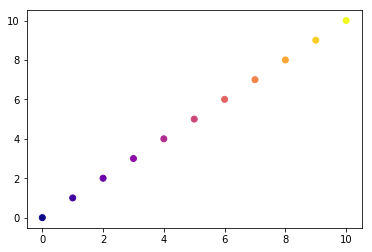

In [425]:
plt.scatter([0,1,2,3,4,5,6,7,8,9,10],[0,1,2,3,4,5,6,7,8,9,10],c=[0,1,2,3,4,5,6,7,8,9,10],cmap='plasma')

In [418]:
print(t1.frameIDs)
print(t1.A)

[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50
 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70]
[ 15417.66   13230.35   14064.95   14178.8    14329.51   12704.04   12099.19
   9456.232  16598.57   16929.53   14377.5    15062.8    18673.74   13139.45
  11622.95    9797.207  12081.64   13498.01   13370.58   12435.62   12139.44
   6854.562   8746.491   9279.691   9863.477   9173.971  11565.05
   9840.945  10851.21   12506.28   12597.92   12746.13    7726.938
   7740.327   6287.529   7764.27    8966.853   8198.818   8286.95
   7435.978   8713.102   7556.957   8314.895   8140.479   7777.91
   6098.964   6659.394   6627.146   8080.864   7775.732   8202.181
   7891.838   7759.116   9137.625   9034.069  10712.92    8255.131
   7001.437   8693.396   6988.806   5425.242   5556.653   5222.904
        nan   6376.525   8331.951   5739.942   8626.23   10339.4     8814.731]


In [314]:
import numpy as np

A = np.array([1, 7, 9, 2, 0.1, 17, 17, 1.5])
k = 3

idx = np.argpartition(A, k)
print(idx)
# [4 0 7 3 1 2 6 5]

[4 0 7 3 1 2 6 5]


In [8]:

a = [ 8.16  ,     18.44 ,11.64 ]
b = [  27.98   ,    31.52  , 40.74]
def distance(a,b):
    dist = np.sqrt((a[0]-b[0])*(a[0]-b[0])+(a[1]-b[1])*(a[1]-b[1])+(a[2]-b[2])*(a[2]-b[2]))
    return dist

print(distance(a,b))

37.5596698601


len(dnmCoords) 351


Text(0.5,0,'chcCoords frame1')

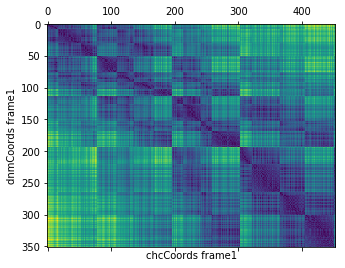

In [9]:
print("len(dnmCoords)",len(dnmCoords))

plt.matshow(distanceMatrix)
plt.ylabel("dnmCoords frame1")
plt.xlabel("chcCoords frame1")

Text(0,0.5,'distance [µm]')

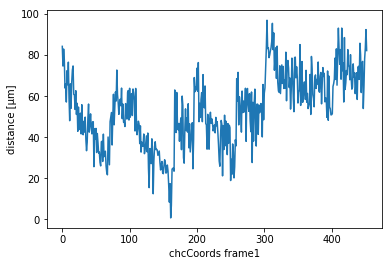

In [10]:
plt.plot(distanceMatrix[100])
plt.xlabel("chcCoords frame1")
plt.ylabel("distance [µm]")

351


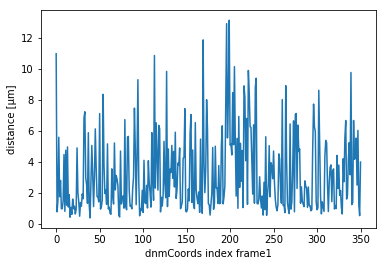

In [11]:
dnmRowsMin = np.amin(distanceMatrix,axis = 1)
print(len(dnmRowsMin))    
plt.plot(dnmRowsMin)
plt.xlabel("dnmCoords index frame1")
plt.ylabel("distance [µm]")
plt.show()

Text(0,0.5,'frequency')

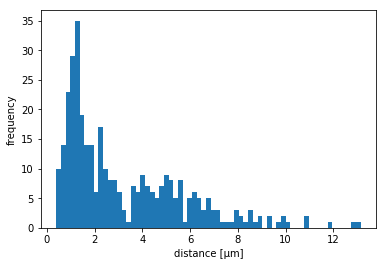

In [12]:
test= plt.hist(dnmRowsMin,bins=65)
#print(test)
plt.xlabel("distance [µm]")
plt.ylabel("frequency")

In [13]:
#print(matchingIDs_chc2dnm)
#matchedIdxs = np.array(matchingIDs_chc2dnm)[:,1]
#print("len(matchedIdxs)",len(matchedIdxs))
#uniques = np.unique(np.array(matchingIDs_chc2dnm)[:,1])
#print("uniques",len(uniques))
#print(uniques)

# go into the data and see what the matches look like

+++++++++++++++++++++++++++++++
0
[5, 6, array([ 10.51,   5.5 ,   9.25]), array([ 10.57,   5.53,  10.03]), 0.78287930104199277]
chc_trackId_2      Value Category  Channel  Time     TrackID  ID  Position X  Position Y  \
2  9151.52     Spot        1     1  1000000002   5       10.57        5.53   

   Position Z Unit Collection  
2       10.03   um   Position  
llkjghjhgkjh
1000000002
+++++++++++++++++++++++++++++++
1
[23, 15, array([ 30.42,  28.84,  31.83]), array([ 30.56,  29.34,  32.66]), 0.97903013232484137]
chc_trackId_2      Value Category  Channel  Time     TrackID  ID  Position X  Position Y  \
11  5907.5     Spot        1     1  1000000011  23       30.56       29.34   

    Position Z Unit Collection  
11       32.66   um   Position  
llkjghjhgkjh
1000000011
+++++++++++++++++++++++++++++++
2
[25, 16, array([ 23.53,  30.29,  35.23]), array([ 22.79,  30.51,  35.85]), 0.99015150355893]
chc_trackId_2       Value Category  Channel  Time     TrackID  ID  Position X  Position Y  \
13

/Users/johannesschoeneberg/anaconda/lib/python3.6/site-packages/matplotlib/pyplot.py:523: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


+++++++++++++++++++++++++++++++
21
[203, 122, array([ 93.52,  45.26,  32.6 ]), array([ 93.85,  45.53,  33.35]), 0.86272823067290472]
chc_trackId_2        Value Category  Channel  Time     TrackID   ID  Position X  Position Y  \
157  7706.67     Spot        1     1  1000000157  203       93.85       45.53   

     Position Z Unit Collection  
157       33.35   um   Position  
llkjghjhgkjh
1000000157
+++++++++++++++++++++++++++++++
22
[207, 124, array([ 72.24,  52.02,  40.34]), array([ 72.42,  52.35,  40.98]), 0.74222638056053558]
chc_trackId_2        Value Category  Channel  Time     TrackID   ID  Position X  Position Y  \
161  12159.9     Spot        1     1  1000000161  207       72.42       52.35   

     Position Z Unit Collection  
161       40.98   um   Position  
llkjghjhgkjh
1000000161
+++++++++++++++++++++++++++++++
23
[259, 158, array([ 31.43,  91.63,  42.28]), array([ 31.21,  90.88,  42.31]), 0.78217645068104658]
chc_trackId_2        Value Category  Channel  Time     TrackID 

+++++++++++++++++++++++++++++++
42
[477, 366, array([  68.14,  123.25,   37.9 ]), array([  68.33,  123.03,   38.7 ]), 0.85117565754666968]
chc_trackId_2        Value Category  Channel  Time     TrackID   ID  Position X  Position Y  \
389  11646.3     Spot        1     1  1000000389  477       68.33      123.03   

     Position Z Unit Collection  
389        38.7   um   Position  
llkjghjhgkjh
1000000389
+++++++++++++++++++++++++++++++
43
[478, 367, array([  89.88,  106.72,   38.53]), array([  89.56,  106.58,   39.39]), 0.92822411086978063]
chc_trackId_2        Value Category  Channel  Time     TrackID   ID  Position X  Position Y  \
390  10978.8     Spot        1     1  1000000390  478       89.56      106.58   

     Position Z Unit Collection  
390       39.39   um   Position  
llkjghjhgkjh
1000000390
+++++++++++++++++++++++++++++++
44
[489, 373, array([  84.52,  101.23,   45.66]), array([  83.88,  101.22,   46.32]), 0.91940197954975367]
chc_trackId_2        Value Category  Channel 

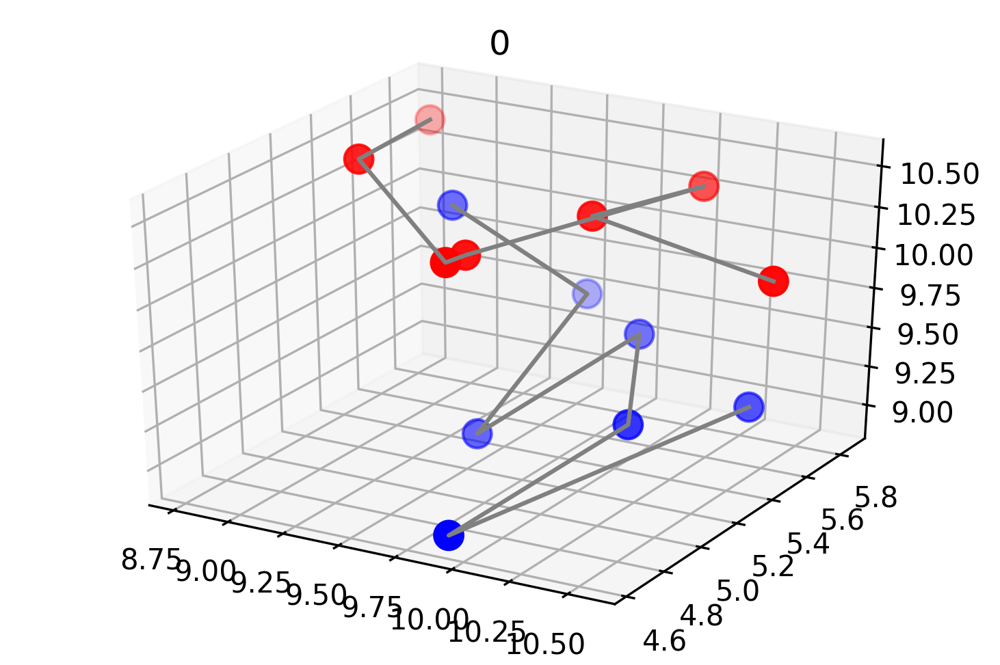

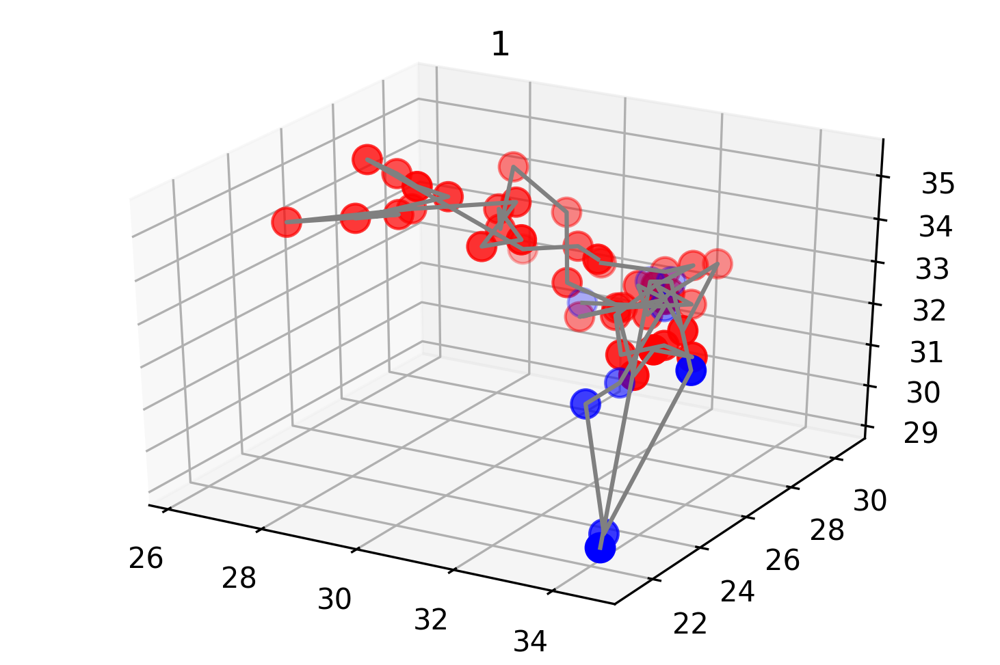

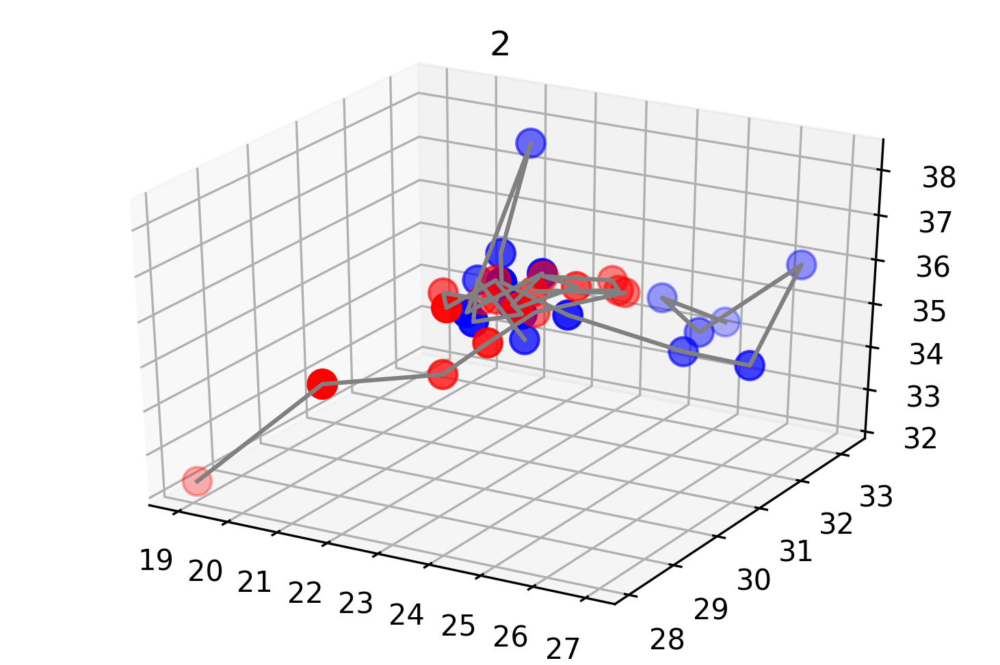

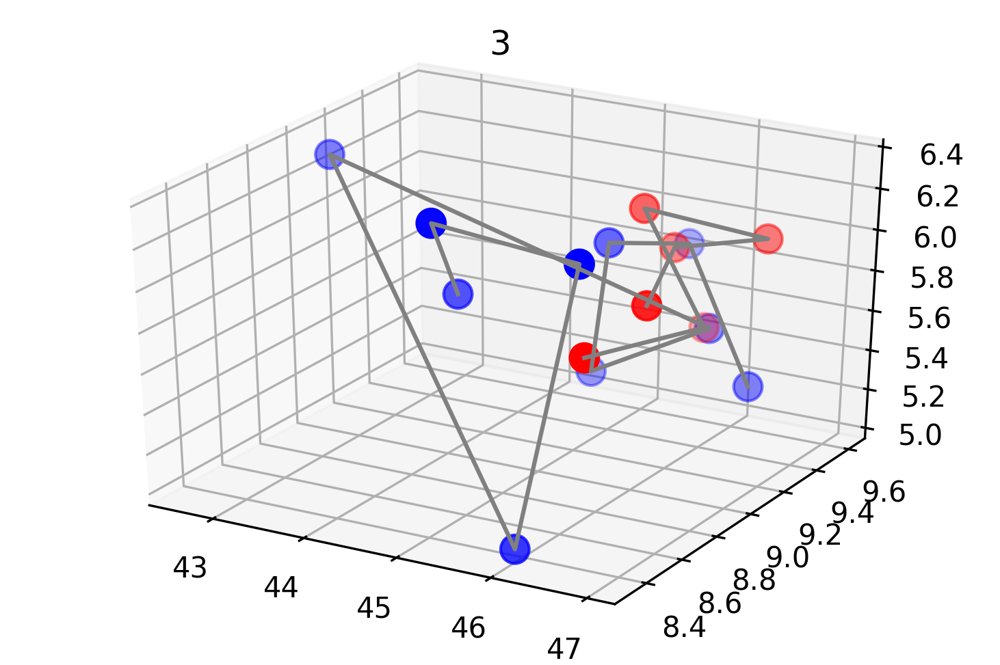

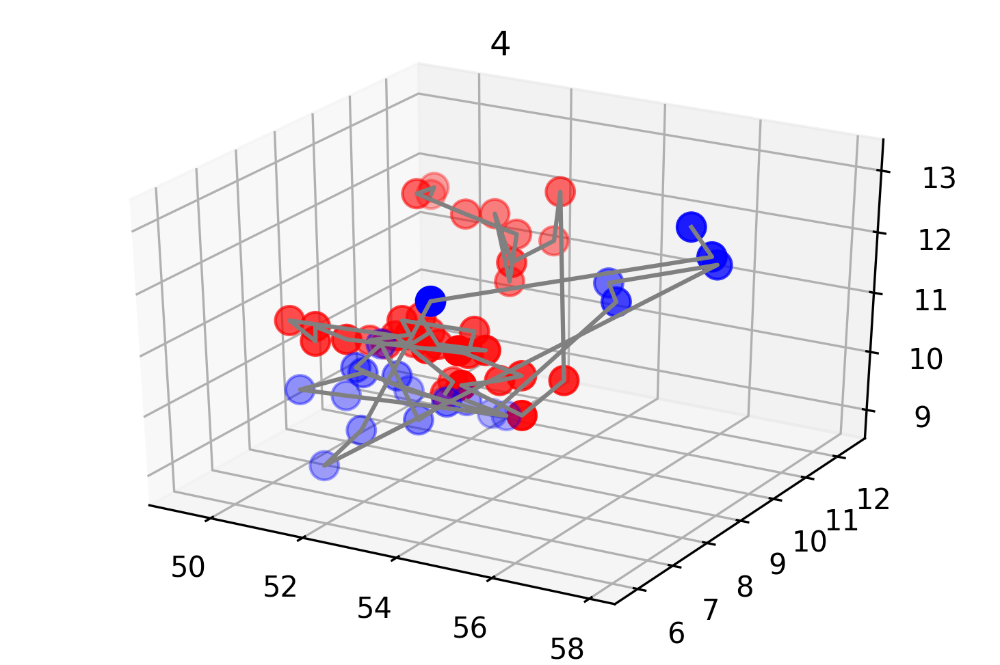

...

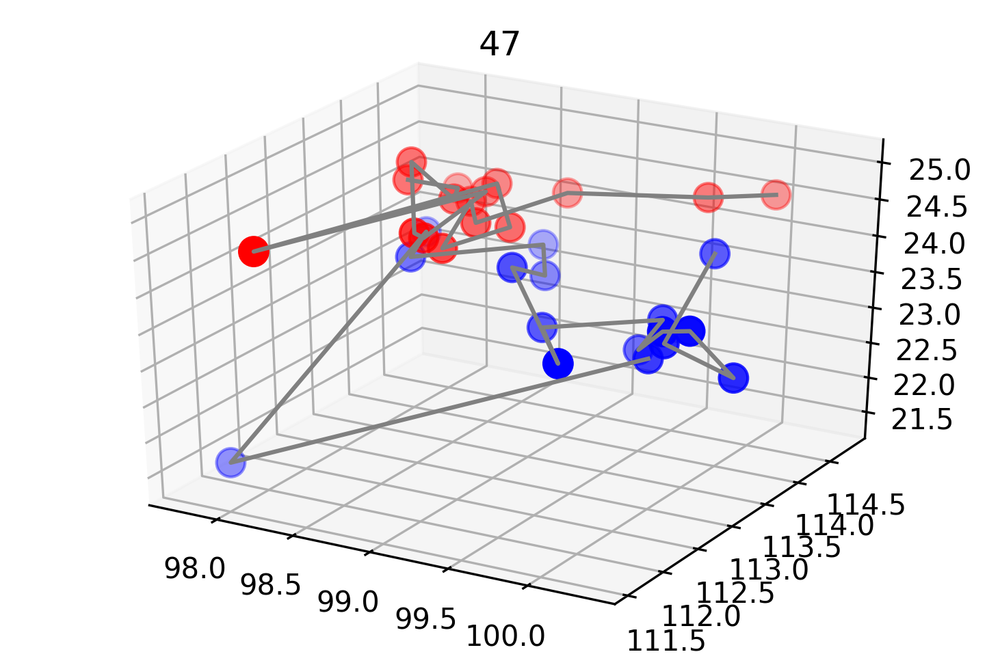

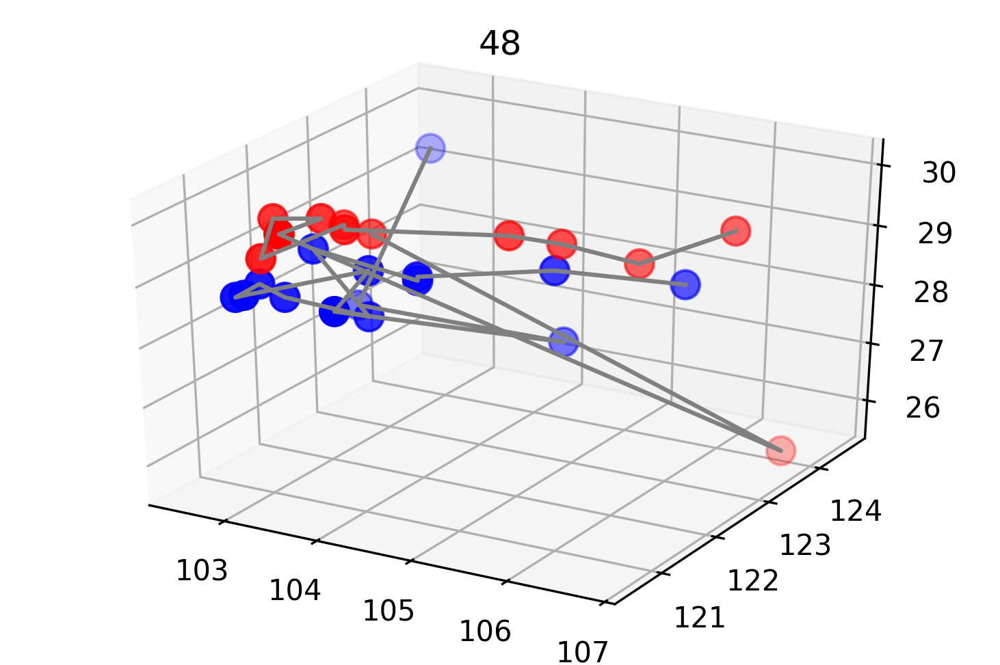

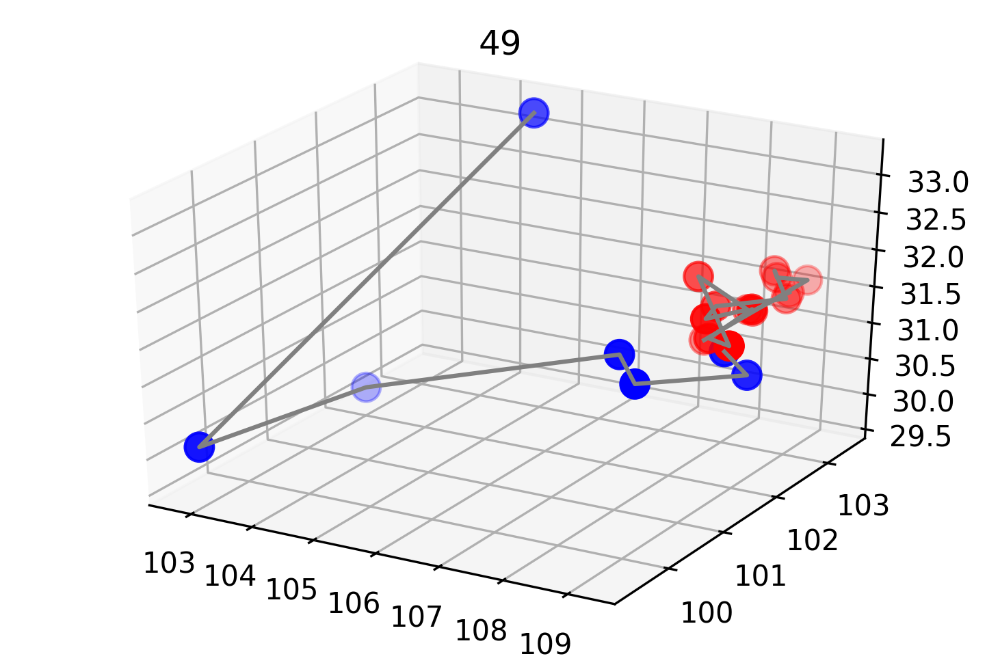

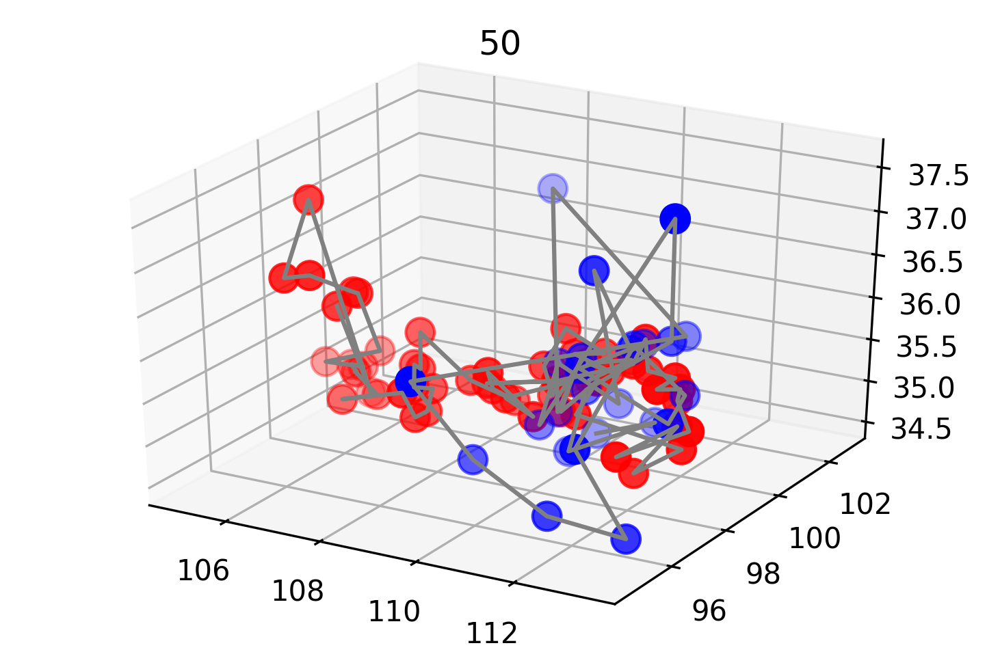

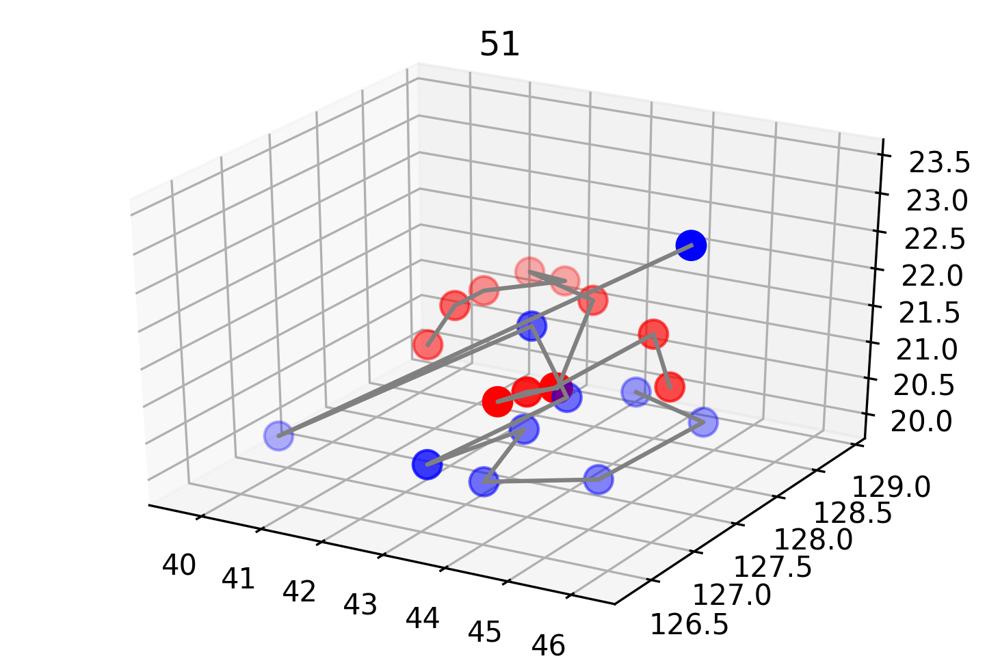

In [25]:

for index in range(0,len(matchingIDs_chc2dnm)):
    print("+++++++++++++++++++++++++++++++")
    print(index)
    print(matchingIDs_chc2dnm[index])
    
    chcID,dnmID,dnmCoord,chcCoord,dist = matchingIDs_chc2dnm[index]
    #print(data_chc.iloc[[chcIdx]])
    #print(data_dnm.iloc[[dnmIdx]])
    chc_trackId_2 = data_chc[data_chc['ID'] == chcID]
    print("chc_trackId_2",chc_trackId_2)
    chc_trackId = data_chc[data_chc['ID'] == chcID][['TrackID']]
    dnm_trackId =data_dnm[data_dnm['ID'] == dnmID][['TrackID']]
    #chc_trackId = data_chc.loc[lambda df: df.ID == chcID, :][['TrackID']]
    #dnm_trackId = data_dnm.loc[lambda df: df.ID == dnmID, :][['TrackID']]
    print("llkjghjhgkjh")
    print(chc_trackId.values[0,0])
#    print(dnm_trackId.values[0,0])
    
    track = data_chc[data_chc['TrackID'] == chc_trackId.values[0,0]]
#    track[0:5]

    calculateAverageDistanceBetweenTracks(track_chc,track_dnm)
    outfilename = 'trackPlot_'+str(index)+".png"
    plot2TracksByTrackId(data_chc,chc_trackId.values[0,0],data_dnm,dnm_trackId.values[0,0],color='red',color2='blue',title=str(index),filename=outfilename)

# calculate a distance metric between tracks

In [26]:
def fromParticleId_getCorrespondingTrack(fullDataset,particleId):
    trackId = fullDataset[fullDataset['ID'] == particleId][['TrackID']]
    track = fullDataset[fullDataset['TrackID'] == trackId.values[0,0]]
    return(track)
    

In [27]:
def calculateAverageDistanceBetweenTracks(trackA,trackB):
    track_chc = trackA
    track_dnm = trackB
    

    # get the two time frame arrays for each track
    track_chc_time = track_chc[['Time']].values
    #print(track_chc_time)
    track_dnm_time = track_dnm[['Time']].values
    #print(track_dnm_time)
    timeIntersection = np.intersect1d(track_chc_time,track_dnm_time)
    #print("timeIntersection",timeIntersection)
    #print("lenA",len(track_chc),"lenB",len(track_dnm),"overlapSize",len(timeIntersection))
    # now go back into the data and calculate the distances for the matching points
    distances = []
    averagedistance = 0
    for commonTimePoint in timeIntersection:
        track_chc_coord = track_chc[track_chc['Time'] == commonTimePoint][['Position X','Position Y','Position Z']].values
        track_dnm_coord = track_dnm[track_dnm['Time'] == commonTimePoint][['Position X','Position Y','Position Z']].values
        dist = np.linalg.norm(track_chc_coord-track_dnm_coord)
        averagedistance = averagedistance + dist
        #print(commonTimePoint,track_chc_coord,track_dnm_coord,dist)
        distances.append(dist)
    averagedistance = averagedistance/len(timeIntersection)
    return(np.round(averagedistance,3))

    

In [28]:


pandasDfCollector = []

for matchIndex in range(0,len(matchingIDs_chc2dnm)):
    #print(matchIndex)
    #print(matchingIDs_chc2dnm[matchIndex])
    
    
    chcID,dnmID,dnmCoord,chcCoord,dist = matchingIDs_chc2dnm[matchIndex]
    
    track_chc = fromParticleId_getCorrespondingTrack(data_chc,chcID)
    track_dnm = fromParticleId_getCorrespondingTrack(data_dnm,dnmID)
    #print(track_dnm)
    
    trackId_chc = data_chc[data_chc['ID'] == chcID][['TrackID']].values[0,0]
    trackId_dnm = data_dnm[data_dnm['ID'] == dnmID][['TrackID']].values[0,0]
    
    # get the two time frame arrays for each track
    track_chc_time = track_chc[['Time']].values
    #print(track_chc_time)
    track_dnm_time = track_dnm[['Time']].values
    #print(track_dnm_time)
    timeIntersection = np.intersect1d(track_chc_time,track_dnm_time)
    #print("timeIntersection",timeIntersection)
    
    trackDistance=calculateAverageDistanceBetweenTracks(track_chc,track_dnm)
    
    title = "track avg distance [µm]: "+str(trackDistance)
    #plot2Tracks(track_chc,track_dnm,color='red',color2='blue',title=title,filename='')
    

    pandasDfCollector.append([trackId_chc,len(track_chc.index),trackId_dnm,len(track_dnm.index),timeIntersection,len(timeIntersection),trackDistance])


df_allTracksDistanceMatrix = pd.DataFrame(pandasDfCollector)
df_allTracksDistanceMatrix.columns = ["trackId_chc","len(track_chc)","trackId_dnm","len(trackId_dnm)","timeIntersection","len(timeIntersection)","trackDistance"]




In [30]:
df_allTracksDistanceMatrix[0:5]

,trackId_chc,len(track_chc),trackId_dnm,len(trackId_dnm),timeIntersection,len(timeIntersection),trackDistance
0,1000000002,7,1000000001,7,"[1, 2, 3, 4, 5, 6, 7]",7,1.055
1,1000000011,41,1000000006,9,"[1, 2, 3, 4, 5, 6, 7, 8, 9]",9,1.996
2,1000000013,17,1000000007,17,"[1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 13, 14, 1...",16,2.424
3,1000000017,6,1000000010,10,"[1, 2, 3, 4, 5, 6]",6,1.153
4,1000000022,35,1000000016,20,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",20,2.260


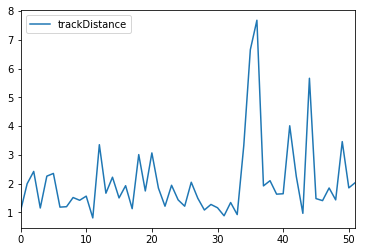

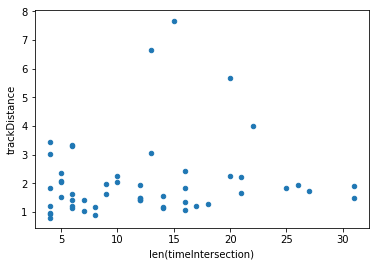

In [31]:
df_allTracksDistanceMatrix[['trackDistance']].plot()
df_allTracksDistanceMatrix.plot.scatter(x='len(timeIntersection)',y='trackDistance')

# calculate distance matrix for each point in each frame, get interesting points

In [32]:
maxTime_dnm = data_dnm[['Time']].iloc[-1].values[0]
maxTime_chc = data_chc[['Time']].iloc[-1].values[0]
maxTime = np.min([maxTime_dnm,maxTime_chc])
print(maxTime)

98


In [33]:
dnmID , trackId_chc = dnm_frame1.iloc[[dnmIdx]][['ID','TrackID']].values[0]
print(dnmID,trackId_chc)

480 1000000350


In [34]:
treshold = 2.0 #µm, have a generous threshold to allow for more matches that we can then filter out later

pandasDfAccumulator = []


# get the maximum timepoint of the dataset
maxTime_dnm = data_dnm[['Time']].iloc[-1].values[0]
maxTime_chc = data_chc[['Time']].iloc[-1].values[0]
maxTime = np.min([maxTime_dnm,maxTime_chc])


for timeFrameId in range(0,maxTime):
    print("timeFrameId",timeFrameId)
    dnm_frame1 = data_dnm.loc[lambda df: df.Time == timeFrameId, :]
    chc_frame1 = data_chc.loc[lambda df: df.Time == timeFrameId, :]
    
    dnmCoords = dnm_frame1[['Position X','Position Y','Position Z']].values
    chcCoords = chc_frame1[['Position X','Position Y','Position Z']].values
    
    distanceMatrix = np.zeros(shape=(len(dnmCoords),len(chcCoords)))
    for dnmIdx in range(0,len(dnmCoords)):
        for chcIdx in range(0,len(chcCoords)):
            dnmCoord = dnmCoords[dnmIdx]
            chcCoord = chcCoords[chcIdx]
            #print(dnmCoord)
            #print(chcCoord)
            dist = np.linalg.norm(dnmCoord-chcCoord)
            #print(dist)
            distanceMatrix[dnmIdx,chcIdx] = dist
    
    
            if(dist<treshold):
                punctaID_chc , trackId_chc = chc_frame1.iloc[[chcIdx]][['ID','TrackID']].values[0]
                punctaID_dnm , trackId_dnm = dnm_frame1.iloc[[dnmIdx]][['ID','TrackID']].values[0]

#                dnmID = dnm_frame1.iloc[[dnmIdx]][['ID','TrackID']].values[0,0]
#                chcID = chc_frame1.iloc[[chcIdx]][['ID','TrackID']].values[0,0]
#                trackId_chc = data_chc[data_chc['ID'] == chcID][['TrackID']].values[0,0]
#                trackId_dnm = data_dnm[data_dnm['ID'] == dnmID][['TrackID']].values[0,0]
                pandasDfAccumulator.append([timeFrameId, punctaID_chc,trackId_chc,chcCoord,punctaID_dnm,trackId_dnm,dnmCoord,dist])
                

df_trackMatch= pd.DataFrame(pandasDfAccumulator)
df_trackMatch.columns = ["timeFrameId", "punctaID_chc","trackId_chc","chcCoord","punctaID_dnm","trackId_dnm","dnmCoord","dist"]            

timeFrameId 0
timeFrameId 1
timeFrameId 2
timeFrameId 3
timeFrameId 4
timeFrameId 5
timeFrameId 6
timeFrameId 7
timeFrameId 8
timeFrameId 9
timeFrameId 10
timeFrameId 11
timeFrameId 12
timeFrameId 13
timeFrameId 14
timeFrameId 15
timeFrameId 16
timeFrameId 17
timeFrameId 18
timeFrameId 19
timeFrameId 20
timeFrameId 21
timeFrameId 22
timeFrameId 23
timeFrameId 24
timeFrameId 25
timeFrameId 26
timeFrameId 27
timeFrameId 28
timeFrameId 29
timeFrameId 30
timeFrameId 31
timeFrameId 32
timeFrameId 33
timeFrameId 34
timeFrameId 35
timeFrameId 36
timeFrameId 37
timeFrameId 38
timeFrameId 39
timeFrameId 40
timeFrameId 41
timeFrameId 42
timeFrameId 43
timeFrameId 44
timeFrameId 45
timeFrameId 46
timeFrameId 47
timeFrameId 48
timeFrameId 49
timeFrameId 50
timeFrameId 51
timeFrameId 52
timeFrameId 53
timeFrameId 54
timeFrameId 55
timeFrameId 56
timeFrameId 57
timeFrameId 58
timeFrameId 59
timeFrameId 60
timeFrameId 61
timeFrameId 62
timeFrameId 63
timeFrameId 64
timeFrameId 65
timeFrameId 66
timeF

In [35]:
df_trackMatch

,timeFrameId,punctaID_chc,trackId_chc,chcCoord,punctaID_dnm,trackId_dnm,dnmCoord,dist
0,1,5,1000000002,"[10.57, 5.53, 10.03]",6,1000000001,"[10.51, 5.5, 9.25]",0.782879
1,1,7,1000000003,"[8.16, 18.44, 11.64]",7,1000000002,"[7.53, 17.5, 10.67]",1.490436
2,1,18,1000000007,"[10.22, 16.75, 28.01]",11,1000000004,"[8.55, 17.26, 28.21]",1.757555
3,1,23,1000000011,"[30.56, 29.34, 32.66]",15,1000000006,"[30.42, 28.84, 31.83]",0.979030
4,1,25,1000000013,"[22.79, 30.51, 35.85]",16,1000000007,"[23.53, 30.29, 35.23]",0.990152
5,1,27,1000000014,"[8.74, 31.26, 38.24]",18,1000000008,"[9.29, 31.35, 36.87]",1.479020
6,1,36,1000000017,"[46.59, 8.75, 6.04]",22,1000000010,"[46.81, 9.23, 5.42]",0.814371
7,1,37,1000000018,"[33.95, 19.11, 6.82]",24,1000000012,"[33.47, 18.88, 5.73]",1.213013
8,1,38,1000000019,"[46.42, 18.21, 7.8]",26,1000000014,"[47.26, 18.65, 7.25]",1.096221
9,1,44,1000000023,"[59.99, 24.11, 10.14]",27,1000000015,"[59.42, 23.39, 8.49]",1.888333


In [182]:
#df_trackMatch.to_csv("df_trackMatch.csv")

# calculate for the matched tracks

In [54]:
matchedTracks = df_trackMatch[['trackId_chc','trackId_dnm']].values
print(matchedTracks)

[[1000000002 1000000001]
 [1000000003 1000000002]
 [1000000007 1000000004]
 ..., 
 [1000001196 1000002357]
 [1000001204 1000002437]
 [1000001197 1000002438]]


In [59]:


#uniques = np.unique(matchedTracks, axis=0)
matchedTracks_uniques = np.vstack({tuple(row) for row in matchedTracks})
print(matchedTracks_uniques)

[[1000000318 1000000219]
 [1000000495 1000000268]
 [1000000937 1000001677]
 ..., 
 [1000000279 1000000184]
 [1000000668 1000000947]
 [1000000536 1000000244]]


In [61]:
import timeit
start_time = timeit.default_timer()



pandasDfCollector = []

iterator = 0
for matchedTrack in matchedTracks_uniques:
    #print(matchedTrack)
    #print(matchingIDs_chc2dnm[matchIndex])
    if(iterator % 100 == 0):
        print(str(iterator) +"/"+str(len(matchedTracks_uniques)))
    
    trackId_chc, trackId_dnm = matchedTrack
    
    track_chc = data_chc[data_chc['TrackID'] == trackId_chc]
    track_dnm = data_dnm[data_dnm['TrackID'] == trackId_dnm]
    
    # get the two time frame arrays for each track
    track_chc_time = track_chc[['Time']].values
    #print(track_chc_time)
    track_dnm_time = track_dnm[['Time']].values
    #print(track_dnm_time)
    timeIntersection = np.intersect1d(track_chc_time,track_dnm_time)
    #print("timeIntersection",timeIntersection)
    
    trackDistance=calculateAverageDistanceBetweenTracks(track_chc,track_dnm)
    
    title = "track avg distance [µm]: "+str(trackDistance)
    #plot2Tracks(track_chc,track_dnm,color='red',color2='blue',title=title,filename='')
    

    pandasDfCollector.append([trackId_chc,len(track_chc.index),trackId_dnm,len(track_dnm.index),timeIntersection,len(timeIntersection),trackDistance])
    iterator=iterator+1
#    if ( iterator == 100):
#        break
df_selectTracksDistanceMatrix = pd.DataFrame(pandasDfCollector)
df_selectTracksDistanceMatrix.columns = ["trackId_chc","len(track_chc)","trackId_dnm","len(trackId_dnm)","timeIntersection","len(timeIntersection)","trackDistance"]


elapsed = timeit.default_timer() - start_time
print(elapsed)


0/1330
100/1330
200/1330
300/1330
400/1330
500/1330
600/1330
700/1330
800/1330
900/1330
1000/1330
1100/1330
1200/1330
1300/1330
28.49553114300943


In [63]:
df_selectTracksDistanceMatrix[0:5]
df_selectTracksDistanceMatrix = .to_csv("selectTracksDistanceMatrix.csv")

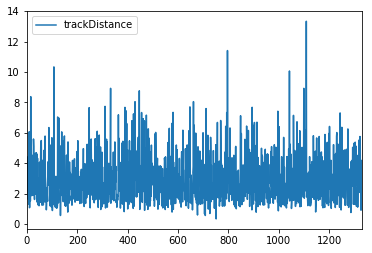

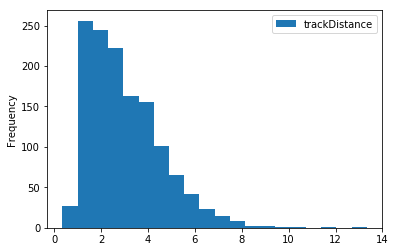

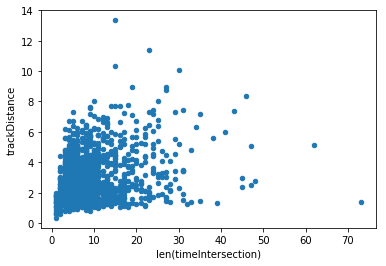

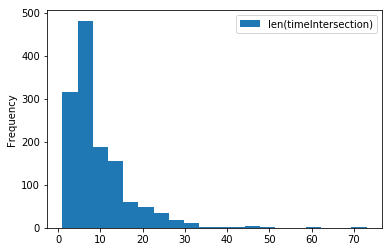

In [64]:
df_selectTracksDistanceMatrix[['trackDistance']].plot()
df_selectTracksDistanceMatrix[['trackDistance']].plot.hist(bins=20)
df_selectTracksDistanceMatrix.plot.scatter(x='len(timeIntersection)',y='trackDistance')
df_selectTracksDistanceMatrix[['len(timeIntersection)']].plot.hist(bins=20)

# plot the top traces from the analysis

In [73]:
bestTracks = df_selectTracksDistanceMatrix.sort_values(by=['len(timeIntersection)','trackDistance', ],ascending=[False,True])[0:40]
bestTracks

,trackId_chc,len(track_chc),trackId_dnm,len(trackId_dnm),timeIntersection,len(timeIntersection),trackDistance
631,1000000377,77,1000000539,95,"[4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16,...",73,1.356
829,1000000576,83,1000001083,62,"[23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 3...",62,5.115
801,1000000434,52,1000000328,49,"[1, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ...",48,2.753
36,1000000576,83,1000000258,52,"[5, 6, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 1...",47,2.536
292,1000000435,57,1000000419,47,"[2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 1...",47,5.076
15,1000000306,67,1000000208,47,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",46,8.383
653,1000000429,46,1000000327,50,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",45,2.366
419,1000000094,98,1000001603,45,"[45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 5...",45,2.936
580,1000000313,55,1000000214,44,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",43,7.350
644,1000000280,65,1000000798,41,"[13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 2...",41,5.991


/Users/johannesschoeneberg/anaconda/lib/python3.6/site-packages/matplotlib/pyplot.py:523: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


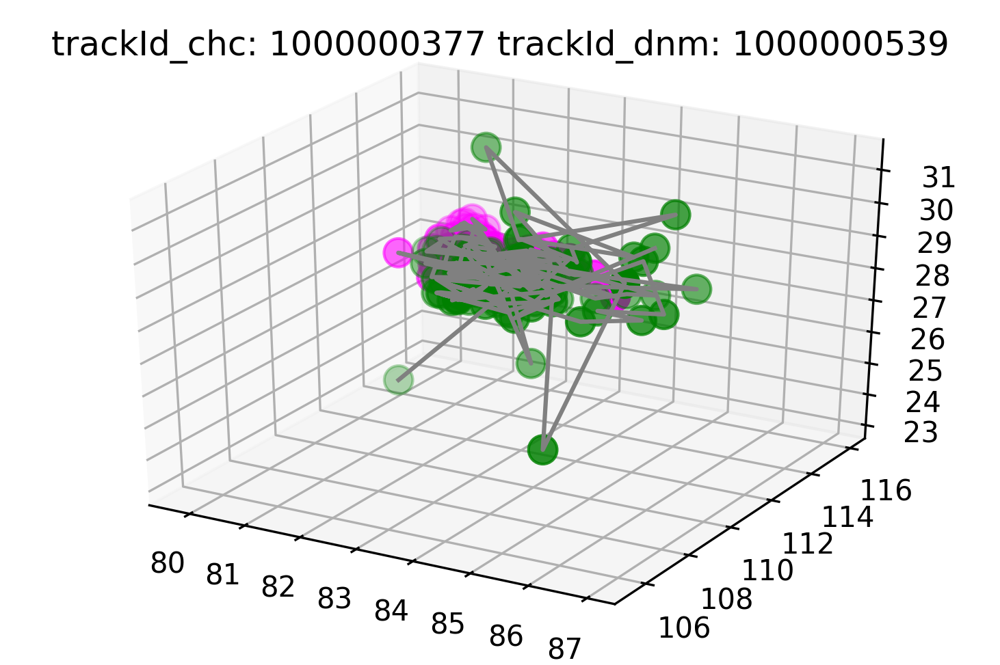

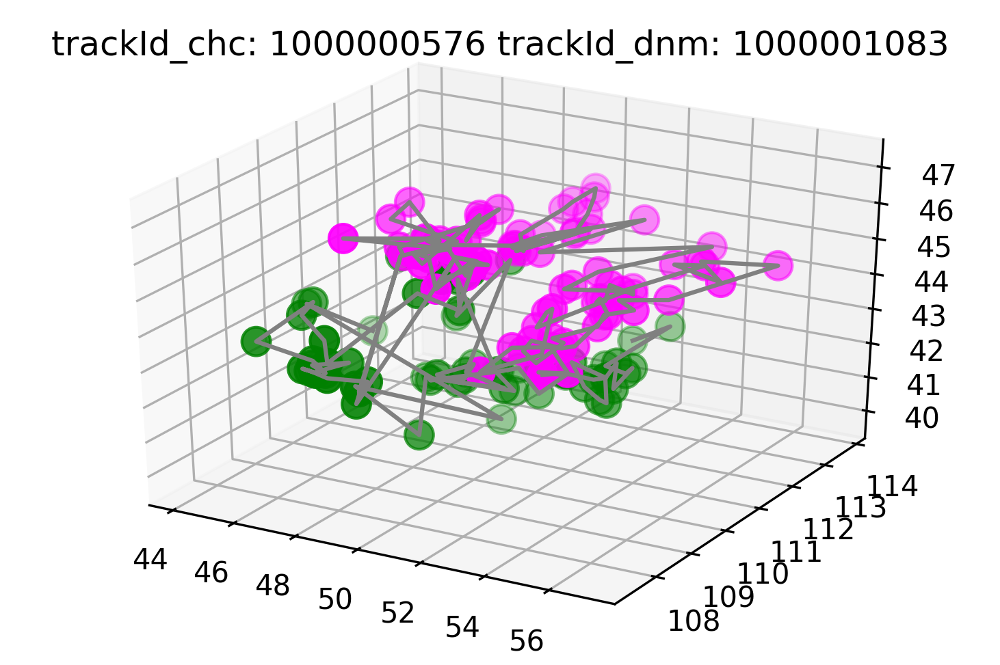

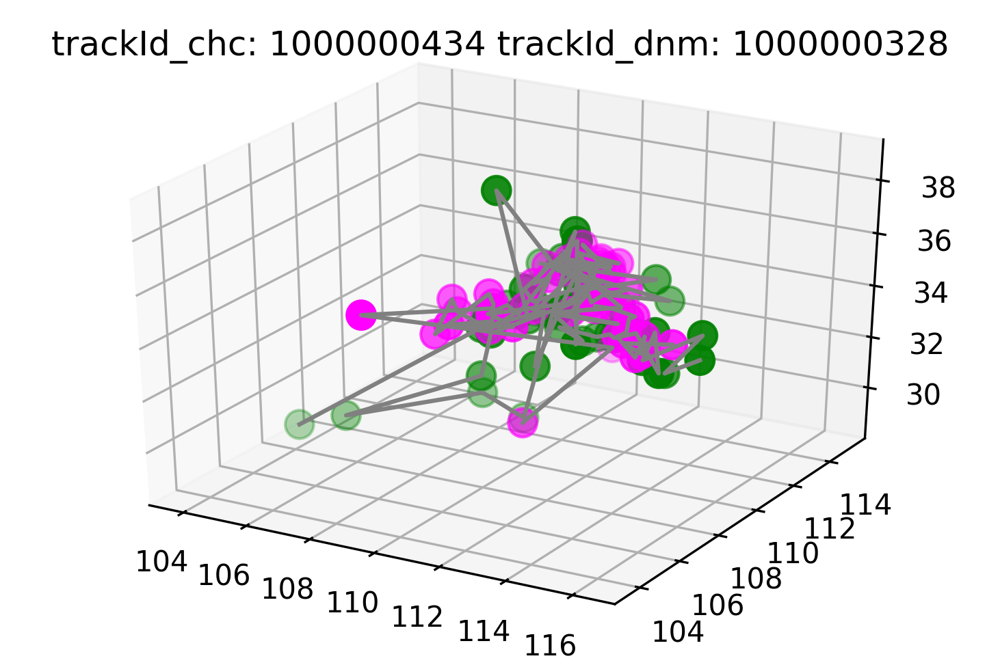

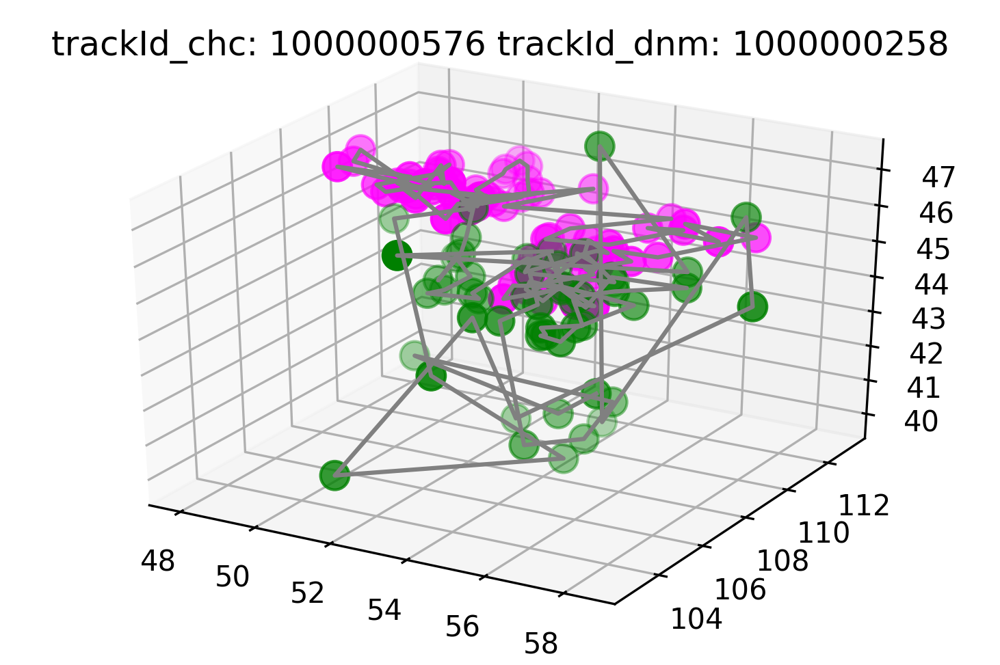

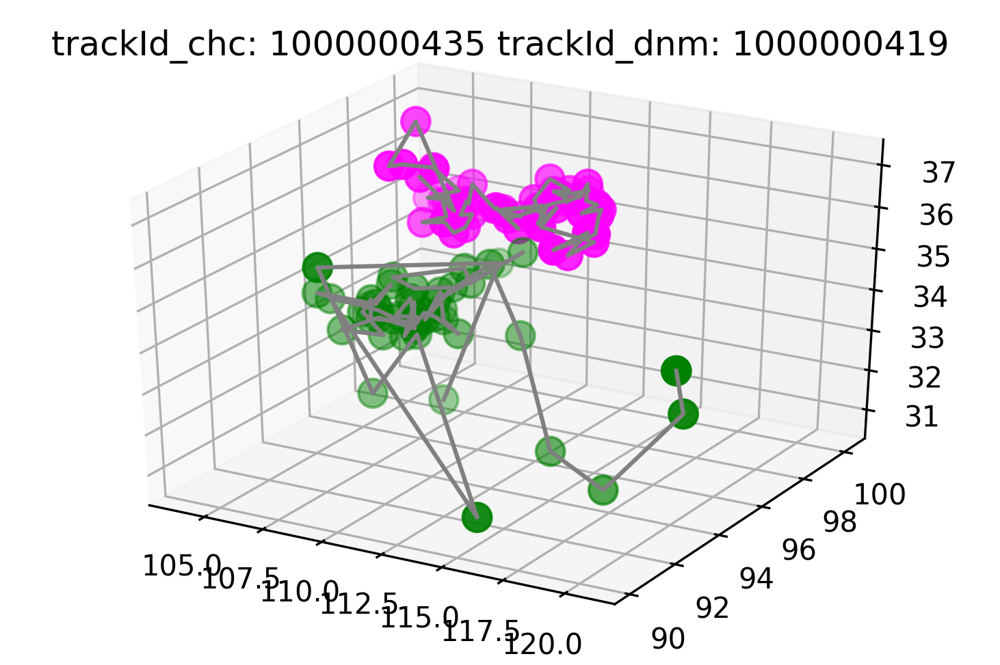

...

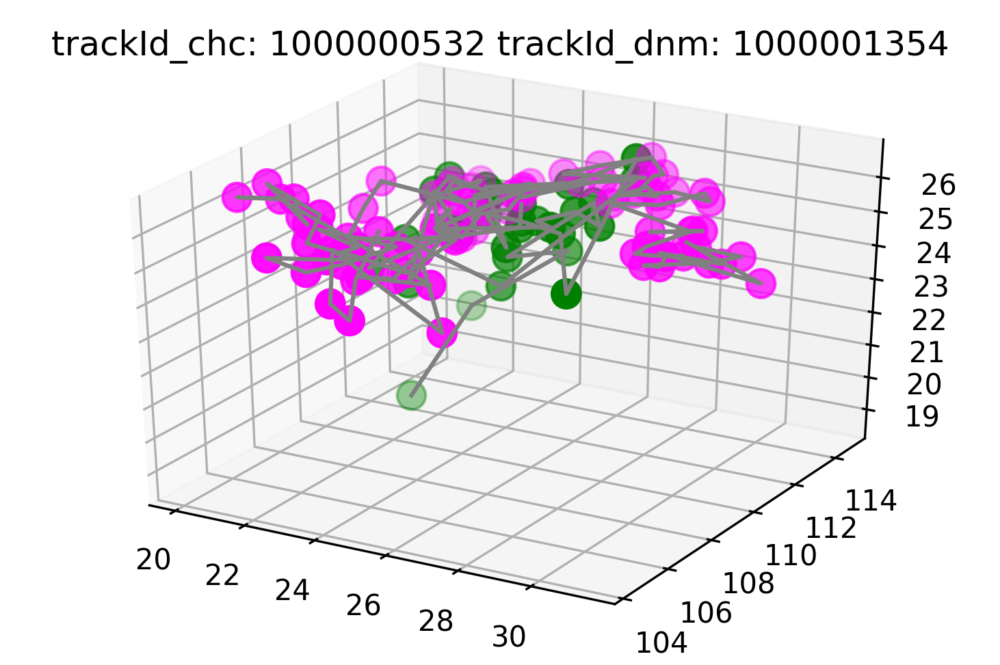

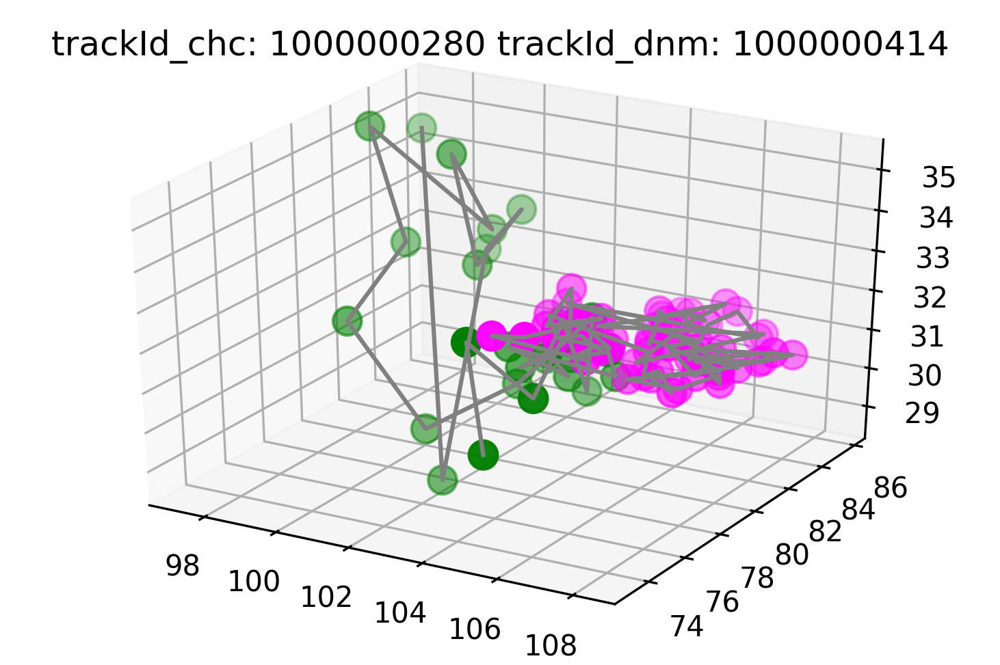

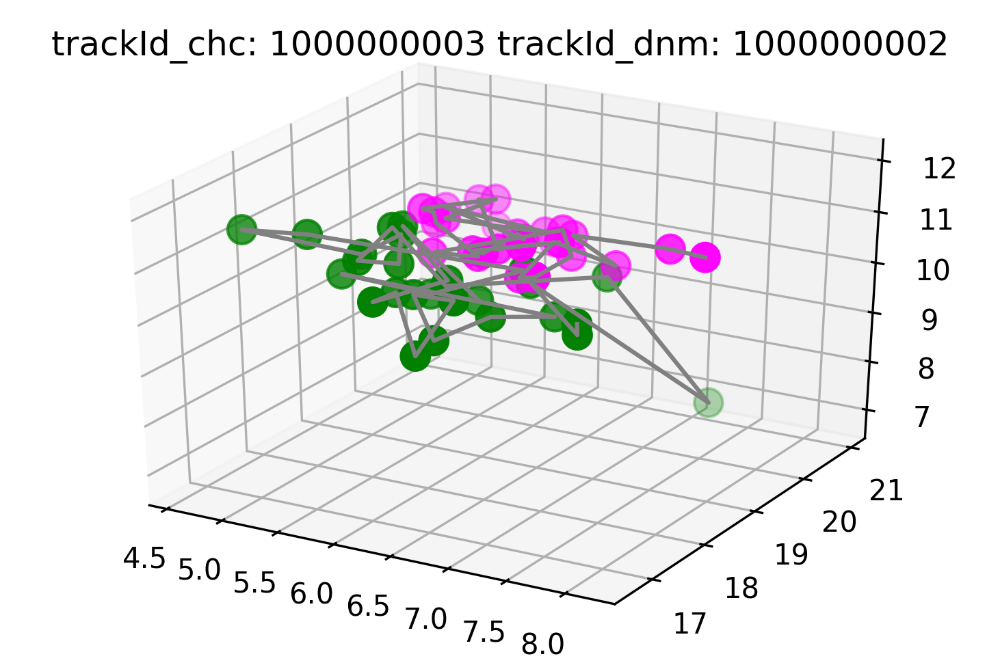

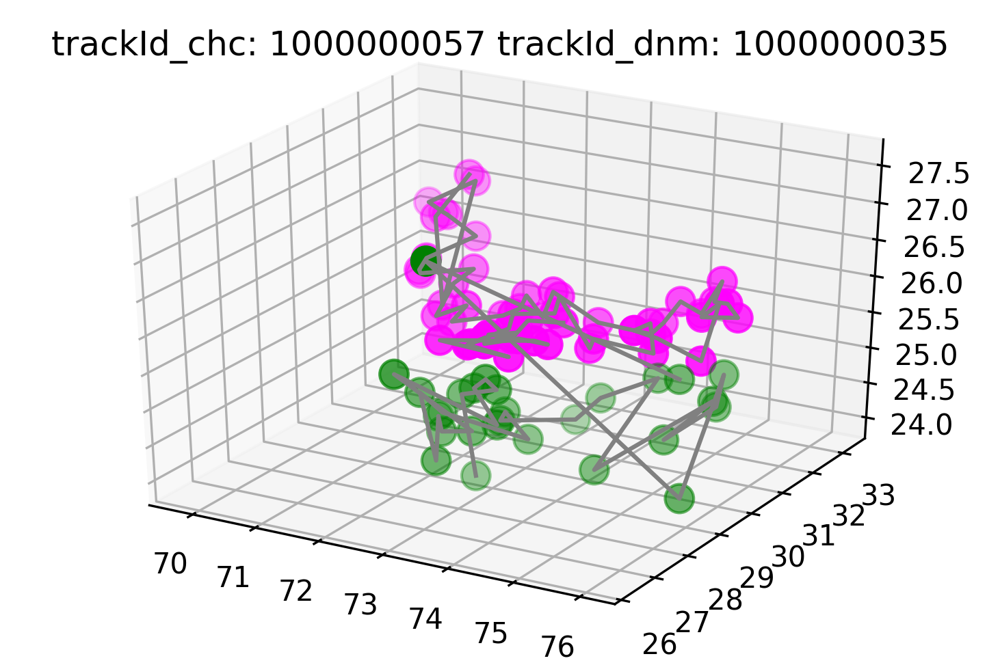

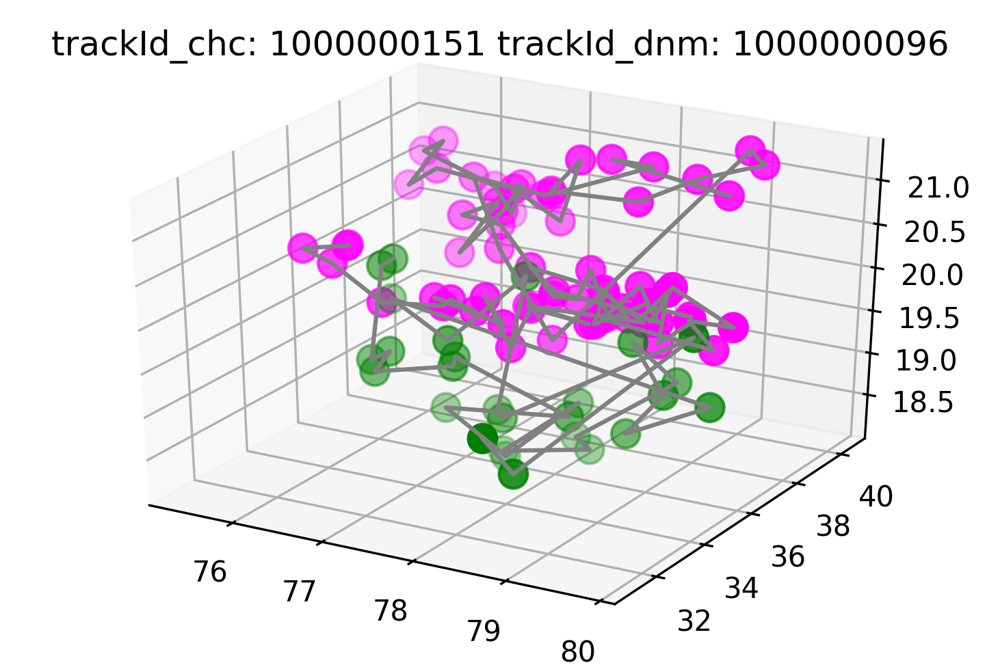

In [74]:
bestTracks_trackIds = bestTracks[['trackId_chc','trackId_dnm']].values
#print(bestTracks_trackIds)
for trackIdPair in bestTracks_trackIds:
    trackId_chc, trackId_dnm = trackIdPair
    #print(trackId_chc, trackId_dnm)
    title = "trackId_chc: "+str(trackId_chc)+" trackId_dnm: "+str(trackId_dnm)
    filename = title+".png"
    plot2TracksByTrackId(data_chc,trackId_chc,data_dnm,trackId_dnm,color='magenta',color2='green',title=title,filename=filename)

# plot the intensity of them over time

In [3]:
trackId_chc, trackId_dnm = bestTracks_trackIds[0]
track = data[data['TrackID'] == trackId]
    plt.figure(dpi=300)
    ax = plt.axes(projection='3d')
    plt.title(title)
    # Data for a three-dimensional line
    x = track['Position X'].values
    y = track['Position Y'].values
    z = track['Position Z'].values
    intensity = track['Value'].values
    ax.plot3D(x, y, z, 'gray')
    
    # Data for three-dimensional scattered points
    #zdata = 15 * np.random.random(100)
    #xdata = np.sin(zdata) + 0.1 * np.random.randn(100)
    #ydata = np.cos(zdata) + 0.1 * np.random.randn(100)
    #ax.scatter(x, y, z, alpha=0.8, c=color, edgecolors='none', s=30, label=group)
    if(color=='intensity'):
        ax.scatter3D(x, y, z, c=intensity, cmap='cool',s=100);
    else:
        ax.scatter3D(x, y, z, c=color, cmap='cool',s=100);
    
    #------------------------------------------------------------------------------------
    # the second one
    data = data2
    trackId = trackId2
    color = color2
    
    track = data[data['TrackID'] == trackId]
#    plt.figure(dpi=300)
#    ax = plt.axes(projection='3d')
    
    # Data for a three-dimensional line
    x = track['Position X'].values
    y = track['Position Y'].values
    z = track['Position Z'].values
    intensity = track['Value'].values
    ax.plot3D(x, y, z, 'gray')
    
    # Data for three-dimensional scattered points
    #zdata = 15 * np.random.random(100)
    #xdata = np.sin(zdata) + 0.1 * np.random.randn(100)
    #ydata = np.cos(zdata) + 0.1 * np.random.randn(100)
    #ax.scatter(x, y, z, alpha=0.8, c=color, edgecolors='none', s=30, label=group)
    if(color=='intensity'):
        ax.scatter3D(x, y, z, c=intensity, cmap='cool',s=100);
    else:
        ax.scatter3D(x, y, z, c=color, cmap='cool',s=100);
        
    if(filename!=''):
        plt.savefig(filename)
    
    plt.close()
        
        

IndentationError: unexpected indent (<ipython-input-3-9e17c90b7e73>, line 3)

# try to calculate this for all tracks in the dataset

In [157]:
import timeit
start_time = timeit.default_timer()

is_looping = True

allTrackIDs = data_chc[['TrackID']].values
print(len(allTrackIDs))
uniqueTrackIDs_chc = np.unique(allTrackIDs)
print(len(uniqueTrackIDs_chc))

allTrackIDs_dnm = data_dnm[['TrackID']].values
print(len(allTrackIDs_dnm))
uniqueTrackIDs_dnm = np.unique(allTrackIDs_dnm)
print(len(uniqueTrackIDs_dnm))


pandasDfCollector = []
iterator = 0
for trackId_chc in uniqueTrackIDs_chc:
    print(iterator)
    
    for trackId_dnm in uniqueTrackIDs_dnm:
        if(iterator % 100 == 0):
            print(iterator)

    
        # get the two time frame arrays for each track
        track_chc_time = track_chc[['Time']].values
        #print(track_chc_time)
        track_dnm_time = track_dnm[['Time']].values
        #print(track_dnm_time)
        timeIntersection = np.intersect1d(track_chc_time,track_dnm_time)
        #print("timeIntersection",timeIntersection)
        
        trackDistance=calculateAverageDistanceBetweenTracks(track_chc,track_dnm)
        
        #title = "track avg distance [µm]: "+str(trackDistance)
        #plot2Tracks(track_chc,track_dnm,color='red',color2='blue',title=title,filename='')
        
    
        pandasDfCollector.append([trackId_chc,len(track_chc.index),trackId_dnm,len(track_dnm.index),timeIntersection,len(timeIntersection),trackDistance])
        iterator = iterator +1
    
    
        if iterator == 1000:
            is_looping = False
            break
            
    if is_looping == False:
        break

df_trackMatch= pd.DataFrame(pandasDfCollector)
df_trackMatch.columns = ["trackId_chc","len(track_chc)","trackId_dnm","len(trackId_dnm)","timeIntersection","len(timeIntersection)","trackDistance"]

elapsed = timeit.default_timer() - start_time
print(elapsed)

15529
1208
28886
2506
0
0
100
200
300
400
500
600
700
800
900
16.49790236300032


# something else

In [53]:
track_chc = data_chc[data_chc['TrackID'] == chc_trackId.values[0,0]]
track_chc[0:5]

,Value,Category,Channel,Time,TrackID,ID,Position X,Position Y,Position Z,Unit,Collection
118,10743.60,Spot,1,1,1000000118,163,51.15,38.74,12.07,um,Position
581,15894.70,Spot,1,2,1000000118,755,51.25,38.45,11.96,um,Position
1050,12506.50,Spot,1,3,1000000118,1355,50.74,38.23,12.09,um,Position
1525,8745.43,Spot,1,4,1000000118,1975,50.96,38.11,12.27,um,Position
2030,10432.60,Spot,1,5,1000000118,2623,50.13,37.99,12.57,um,Position


In [54]:
track_dnm = data_dnm[data_dnm['TrackID'] == dnm_trackId.values[0,0]]
track_dnm[0:5]

,Value,Category,Channel,Time,TrackID,ID,Position X,Position Y,Position Z,Unit,Collection
81,14216.6,Spot,1,1,1000000081,105,51.24,38.33,11.25,um,Position
438,23552.9,Spot,1,2,1000000081,593,50.64,37.92,11.47,um,Position
835,19561.9,Spot,1,3,1000000081,1112,51.26,37.74,11.57,um,Position
1222,14609.9,Spot,1,4,1000000081,1625,50.79,37.53,11.36,um,Position
1625,20432.7,Spot,1,5,1000000081,2164,50.98,37.73,11.65,um,Position


In [68]:
calculateAverageDistance(track_chc,track_dnm)

lenA 25 lenB 14 overlapSize 14
averagedistance 1.12897610964


In [55]:



#========== calculate distance


print(len(track_chc),len(track_dnm))
#if(len(track_chc)>len(track_dnm)):

# get the two time frame arrays for each track
track_chc_time = track_chc[['Time']].values
print(track_chc_time)
track_dnm_time = track_dnm[['Time']].values
print(track_dnm_time)
timeIntersection = np.intersect1d(track_chc_time,track_dnm_time)
print("timeIntersection",timeIntersection)

# now go back into the data and calculate the distances for the matching points
distances = []
averagedistance = 0
for commonTimePoint in timeIntersection:
    track_chc_coord = track_chc[track_chc['Time'] == commonTimePoint][['Position X','Position Y','Position Z']].values
    track_dnm_coord = track_dnm[track_dnm['Time'] == commonTimePoint][['Position X','Position Y','Position Z']].values
    dist = np.linalg.norm(track_chc_coord-track_dnm_coord)
    averagedistance = averagedistance + dist
    print(commonTimePoint,track_chc_coord,track_dnm_coord,dist)
    distances.append(dist)
averagedistance = averagedistance/len(timeIntersection)
print('averagedistance',averagedistance)

    

25 14
[[ 1]
 [ 2]
 [ 3]
 [ 4]
 [ 5]
 [ 6]
 [ 7]
 [ 8]
 [ 9]
 [10]
 [11]
 [12]
 [13]
 [15]
 [16]
 [17]
 [18]
 [20]
 [21]
 [22]
 [24]
 [25]
 [14]
 [19]
 [23]]
[[ 1]
 [ 2]
 [ 3]
 [ 4]
 [ 5]
 [ 6]
 [ 7]
 [ 8]
 [ 9]
 [10]
 [11]
 [12]
 [13]
 [14]]
timeIntersection [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14]
1 [[ 51.15  38.74  12.07]] [[ 51.24  38.33  11.25]] 0.921194876234
2 [[ 51.25  38.45  11.96]] [[ 50.64  37.92  11.47]] 0.945039681707
3 [[ 50.74  38.23  12.09]] [[ 51.26  37.74  11.57]] 0.883685464405
4 [[ 50.96  38.11  12.27]] [[ 50.79  37.53  11.36]] 1.09242848736
5 [[ 50.13  37.99  12.57]] [[ 50.98  37.73  11.65]] 1.2792575972
6 [[ 50.22  37.53  12.58]] [[ 50.58  37.54  11.91]] 0.760657610229
7 [[ 49.37  37.8   12.43]] [[ 50.66  37.18  11.77]] 1.57610278853
8 [[ 50.42  37.76  12.42]] [[ 50.6   37.2   11.76]] 0.884081444212
9 [[ 50.15  38.37  12.86]] [[ 50.67  37.66  12.08]] 1.17596768663
10 [[ 49.59  37.72  12.45]] [[ 50.45  36.67  12.21]] 1.37829604948
11 [[ 49.52  37.99  12.71]] [[ 4

# plot a track

In [20]:
def plotTrack(data,trackId,color='intensity'):
    track = data[data['TrackID'] == trackId]
    plt.figure(dpi=300)
    ax = plt.axes(projection='3d')
    
    # Data for a three-dimensional line
    x = track['Position X'].values
    y = track['Position Y'].values
    z = track['Position Z'].values
    intensity = track['Value'].values
    ax.plot3D(x, y, z, 'gray')
    
    # Data for three-dimensional scattered points
    #zdata = 15 * np.random.random(100)
    #xdata = np.sin(zdata) + 0.1 * np.random.randn(100)
    #ydata = np.cos(zdata) + 0.1 * np.random.randn(100)
    #ax.scatter(x, y, z, alpha=0.8, c=color, edgecolors='none', s=30, label=group)
    if(color=='intensity'):
        ax.scatter3D(x, y, z, c=intensity, cmap='cool',s=100);
    else:
        ax.scatter3D(x, y, z, c=color, cmap='cool',s=100);

In [24]:
def plot2TracksByTrackId(data,trackId,data2,trackId2,color='intensity',color2='intensity',title='',filename=''):
    track = data[data['TrackID'] == trackId]
    plt.figure(dpi=300)
    ax = plt.axes(projection='3d')
    plt.title(title)
    # Data for a three-dimensional line
    x = track['Position X'].values
    y = track['Position Y'].values
    z = track['Position Z'].values
    intensity = track['Value'].values
    ax.plot3D(x, y, z, 'gray')
    
    # Data for three-dimensional scattered points
    #zdata = 15 * np.random.random(100)
    #xdata = np.sin(zdata) + 0.1 * np.random.randn(100)
    #ydata = np.cos(zdata) + 0.1 * np.random.randn(100)
    #ax.scatter(x, y, z, alpha=0.8, c=color, edgecolors='none', s=30, label=group)
    if(color=='intensity'):
        ax.scatter3D(x, y, z, c=intensity, cmap='cool',s=100);
    else:
        ax.scatter3D(x, y, z, c=color, cmap='cool',s=100);
    
    #------------------------------------------------------------------------------------
    # the second one
    data = data2
    trackId = trackId2
    color = color2
    
    track = data[data['TrackID'] == trackId]
#    plt.figure(dpi=300)
#    ax = plt.axes(projection='3d')
    
    # Data for a three-dimensional line
    x = track['Position X'].values
    y = track['Position Y'].values
    z = track['Position Z'].values
    intensity = track['Value'].values
    ax.plot3D(x, y, z, 'gray')
    
    # Data for three-dimensional scattered points
    #zdata = 15 * np.random.random(100)
    #xdata = np.sin(zdata) + 0.1 * np.random.randn(100)
    #ydata = np.cos(zdata) + 0.1 * np.random.randn(100)
    #ax.scatter(x, y, z, alpha=0.8, c=color, edgecolors='none', s=30, label=group)
    if(color=='intensity'):
        ax.scatter3D(x, y, z, c=intensity, cmap='cool',s=100);
    else:
        ax.scatter3D(x, y, z, c=color, cmap='cool',s=100);
        
    if(filename!=''):
        plt.savefig(filename)

In [22]:
def plot2Tracks(trackA,trackB,color='intensity',color2='intensity',title='',filename=''):
    track = trackA
    plt.figure(dpi=300)
    ax = plt.axes(projection='3d')
    plt.title(title)
    # Data for a three-dimensional line
    x = track['Position X'].values
    y = track['Position Y'].values
    z = track['Position Z'].values
    intensity = track['Value'].values
    ax.plot3D(x, y, z, 'gray')
    
    # Data for three-dimensional scattered points
    #zdata = 15 * np.random.random(100)
    #xdata = np.sin(zdata) + 0.1 * np.random.randn(100)
    #ydata = np.cos(zdata) + 0.1 * np.random.randn(100)
    #ax.scatter(x, y, z, alpha=0.8, c=color, edgecolors='none', s=30, label=group)
    if(color=='intensity'):
        ax.scatter3D(x, y, z, c=intensity, cmap='cool',s=100);
    else:
        ax.scatter3D(x, y, z, c=color, cmap='cool',s=100);
    
    #------------------------------------------------------------------------------------
    # the second one

    color = color2
    
    track = trackB
#    plt.figure(dpi=300)
#    ax = plt.axes(projection='3d')
    
    # Data for a three-dimensional line
    x = track['Position X'].values
    y = track['Position Y'].values
    z = track['Position Z'].values
    intensity = track['Value'].values
    ax.plot3D(x, y, z, 'gray')
    
    # Data for three-dimensional scattered points
    #zdata = 15 * np.random.random(100)
    #xdata = np.sin(zdata) + 0.1 * np.random.randn(100)
    #ydata = np.cos(zdata) + 0.1 * np.random.randn(100)
    #ax.scatter(x, y, z, alpha=0.8, c=color, edgecolors='none', s=30, label=group)
    if(color=='intensity'):
        ax.scatter3D(x, y, z, c=intensity, cmap='cool',s=100);
    else:
        ax.scatter3D(x, y, z, c=color, cmap='cool',s=100);
        
    if(filename!=''):
        plt.savefig(filename)

In [5]:
track = data_chc[data_chc['TrackID'] == 1000000000]
track[0:5]

,Value,Category,Channel,Time,TrackID,ID,Position X,Position Y,Position Z,Unit,Collection
0,9167.00,Spot,1,1,1000000000,1,7.74,9.18,7.08,um,Position
453,10135.90,Spot,1,2,1000000000,580,7.80,9.39,7.17,um,Position
923,8762.52,Spot,1,3,1000000000,1184,7.06,9.32,7.20,um,Position
1392,10219.80,Spot,1,4,1000000000,1789,7.59,9.00,7.34,um,Position
1898,12826.80,Spot,1,5,1000000000,2448,7.03,9.03,7.29,um,Position


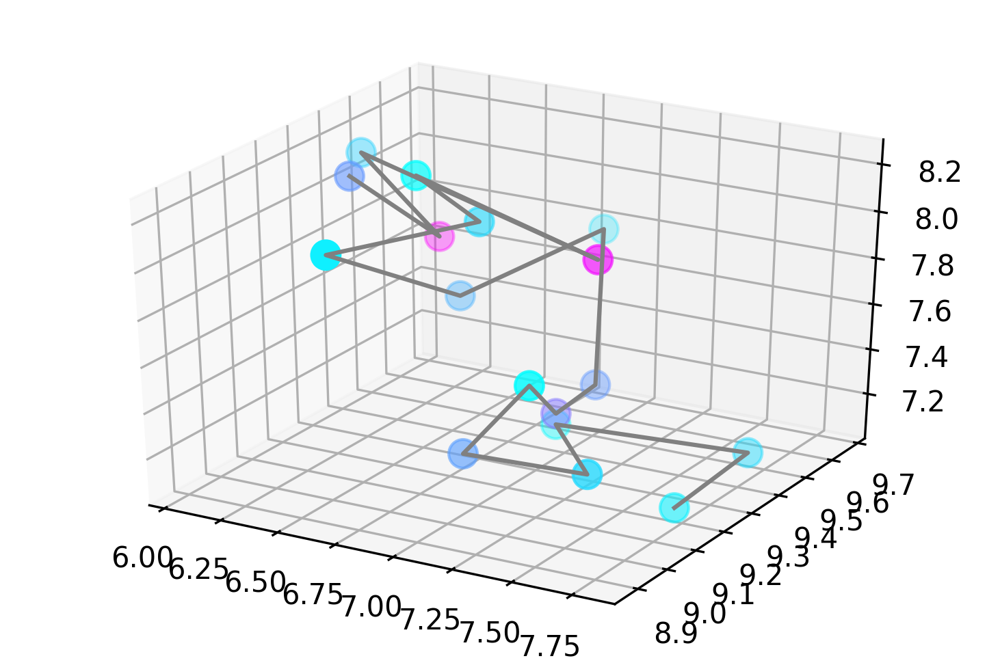

In [26]:
plt.figure(dpi=300)
ax = plt.axes(projection='3d')

# Data for a three-dimensional line
x = track['Position X'].values
y = track['Position Y'].values
z = track['Position Z'].values
intensity = track['Value'].values
ax.plot3D(x, y, z, 'gray')

# Data for three-dimensional scattered points
#zdata = 15 * np.random.random(100)
#xdata = np.sin(zdata) + 0.1 * np.random.randn(100)
#ydata = np.cos(zdata) + 0.1 * np.random.randn(100)
#ax.scatter(x, y, z, alpha=0.8, c=color, edgecolors='none', s=30, label=group)
ax.scatter3D(x, y, z, c=intensity, cmap='cool',s=100);

# plot them all

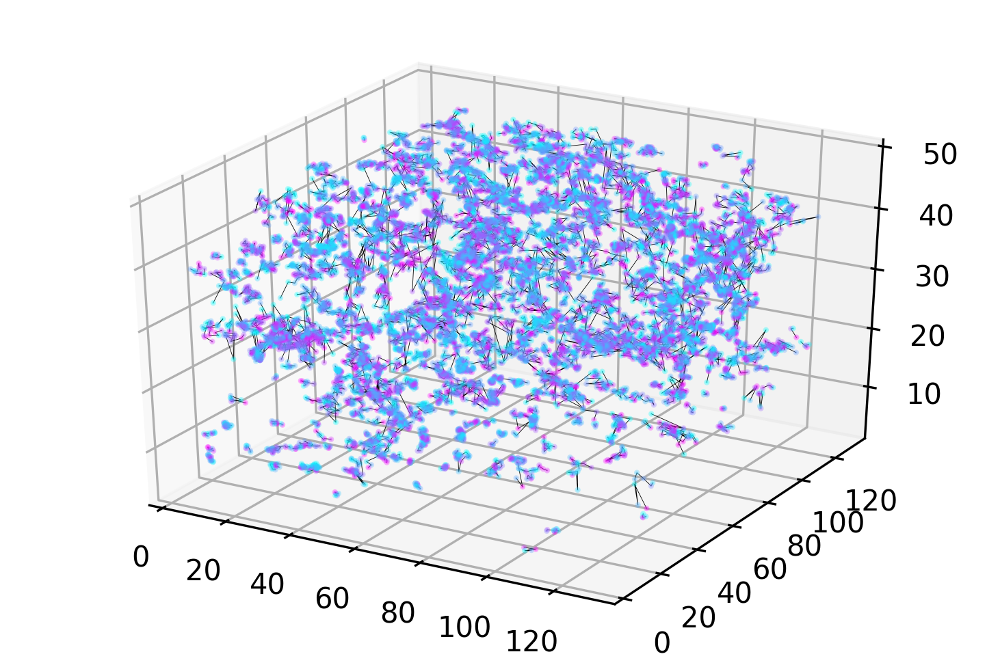

In [21]:
#plot them all

# WARNING: this takes ~3 min to plot.

#   plt.figure(dpi=300)
#   
#   
#   ax = plt.axes(projection='3d')
#   
#   for trackID in np.unique(data_chc['TrackID'].values):
#       
#       
#       track = data_chc[data_chc['TrackID'] == trackID]
#   
#       # Data for a three-dimensional line
#       x = track['Position X'].values
#       y = track['Position Y'].values
#       z = track['Position Z'].values
#       intensity = track['Value'].values
#       ax.plot3D(x, y, z, 'k',lw=0.2)
#       ax.scatter3D(x, y, z, c=intensity, cmap='cool',s=1,alpha=0.3);

In [14]:
nrows = len(data_chc['TrackID'].values)
ntracks = len(np.unique(data_chc['TrackID'].values))
print("nrows",nrows)
print("ntracks",ntracks)



nrows 15529
ntracks 1208
